In [2]:
import tensorflow as tf
tf.test.gpu_device_name()

'/device:GPU:0'

# **Import libraries**

for Read dicom images

In [3]:
pip install pydicom 


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [4]:
pip install SimpleITK

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.7/52.7 MB 16.4 MB/s eta 0:00:00


In [5]:
# visualisation
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import pydicom
import pydicom as dicom
from skimage import io
import os

# handle table-like data and matrices
import pandas as pd
import numpy as np
import glob
import random
import tensorflow.keras.backend as kb

# ignore warnings
import warnings
warnings.filterwarnings('ignore')

# model
from keras import backend as K
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow as tf
from tensorflow.keras.layers import *
from keras.callbacks import ModelCheckpoint
from tensorflow.keras.utils import plot_model
from tensorflow.keras import Model
from tensorflow.keras.models import load_model, save_model

# Bring in the sequential api for the generator and discriminator
from tensorflow.keras.models import Sequential

# Bring in the layers for the neural network
from tensorflow.keras.layers import Conv2D, Dense, Flatten, Reshape, LeakyReLU, Dropout, UpSampling2D

from tqdm import tqdm
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

from keras.models import Sequential, Model
from keras.layers import Dense, Flatten, Conv2D, Reshape, Input, Conv2DTranspose
from keras.layers import Activation, LeakyReLU, BatchNormalization, Dropout, Resizing
from keras.losses import BinaryCrossentropy
from tensorflow.keras.applications import VGG16
try:
    from tensorflow.keras.optimizers import Adam
except:
    from keras.optimizers import Adam

# import necessary packages
import time
import glob
import matplotlib
import matplotlib.image as mpimg
matplotlib.use('Agg')
%matplotlib inline
import PIL
import imageio

import SimpleITK as sitk
from IPython import display
from IPython.display import Image
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from PIL import Image
from tensorflow.keras.optimizers import Adam
from matplotlib import *
from matplotlib import pyplot
from matplotlib.pyplot import *
import sys
from skimage import metrics
from skimage.metrics import structural_similarity as ssim

Content My Drive

In [6]:
from google.colab import drive

drive.mount('/content/drive')

Mounted at /content/drive


# **Convert Data From Dicom To Png**

In [ ]:
dicom_folder = input('input path')
print(dicom_folder)
png_folder = input('output path')
print(png_folder)

for filename in os.listdir(dicom_folder):
    
    if filename.endswith('.dcm'):
        ds = pydicom.dcmread(os.path.join(dicom_folder, filename))
        img = Image.fromarray(ds.pixel_array)
        png_filename = os.path.splitext(filename)[0] + '.png'
        img.save(os.path.join(png_folder, png_filename))


# **dealing with data**

Read Data From Drive

In [8]:
Patients_Directory_Path = "/content/drive/MyDrive/Total_Clean_Data_png(3)"
Patients_Directory = os.listdir(Patients_Directory_Path)
Patients_Directory.sort()

Splitting data

In [9]:
train_ratio=1

In [10]:
random.seed(1)

train_patients = random.sample(Patients_Directory, int(len(Patients_Directory)*train_ratio))


 **Training Dataset**

In [11]:
train_images = []

for patient in train_patients:
    patient_path = os.path.join(Patients_Directory_Path, patient)
    for filename in os.listdir(patient_path):
        f_path = os.path.join(patient_path, filename)
        train_images.append(f_path)
       


check Training Data

In [12]:
print(len(train_images))

606


convert to a Numpy array

In [16]:
train_size = len(train_images)
training_images=np.array([np.array(Image.open(i),dtype="float32") for i in train_images[0:train_size]])
print('training images',training_images.shape)

training images (606, 256, 256)


# **Preprocessing**

Images Sample Before Normalize

In [21]:
print(training_images[0][5])

[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1.
 1. 2. 2. 2. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 2. 2. 2. 3. 4. 3. 2. 1. 2. 2. 1. 1. 1. 1. 1. 2.
 2. 2. 1. 1. 1. 2. 2. 2. 1. 2. 2. 2. 1. 1. 2. 2. 1. 2. 1. 1. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


Normalize pixel values

In [22]:
training_images = (training_images - 127.5 ) / 127.5

In [24]:
print(training_images[0][5])

[-1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         

Make into 4D array

In [25]:
training_images=training_images[:,:,:,np.newaxis]

Check shape

In [26]:
print(training_images.shape)

(606, 256, 256, 1)


# **Check the brain images**

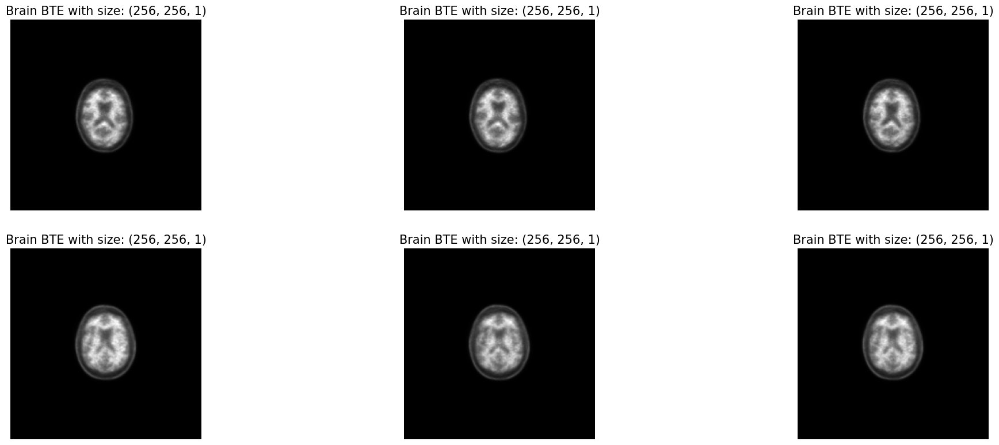

In [28]:
pyplot.figure(figsize=(25,25))
for i in range(6):
    pyplot.subplot(5, 3, 1 + i)
    pyplot.axis('off')
    pyplot.title('Brain BTE with size: {}'.format(training_images[0].shape),fontsize=15)
    pyplot.imshow(training_images[i,:,:,0],cmap='gray')
pyplot.show()


# **Build Generator and discriminator**

In [29]:
def Generator():

    model = tf.keras.Sequential()

    model.add(Dense(32*32*256, input_shape=(256,)))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Reshape((32, 32,256)))

    model.add(Conv2DTranspose(256, (4,4), strides=(2,2), padding='same', use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))
    
    
    model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same', use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))
    
    
    model.add(Conv2DTranspose(64, (4,4), strides=(2,2), padding='same', use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))
    

    model.add(Conv2D(64, (3,3), strides=(1,1), padding='same', use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))


    model.add(Conv2D(1, (3,3),strides=(1,1), padding='same', use_bias=False))
    
    return model

Check Generator Summary

In [30]:
g_model = Generator()
g_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 262144)            67371008  
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 262144)            0         
                                                                 
 reshape (Reshape)           (None, 32, 32, 256)       0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 64, 64, 256)      1048576   
 nspose)                                                         
                                                                 
 batch_normalization (BatchN  (None, 64, 64, 256)      1024      
 ormalization)                                                   
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 64, 64, 256)       0

In [31]:
def Discriminator(input=(256,256,1)):

    model = tf.keras.Sequential()

    model.add(Conv2D(16, (4,4), strides=(2, 2), padding='same',input_shape=input))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))
    model.add(Dropout(0.4))
    
    model.add(Conv2D(32, (4,4), strides=(2, 2), padding='same'))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))
    model.add(Dropout(0.4))
    
    
    model.add(Conv2D(64, (4,4), strides=(2, 2), padding='same'))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))
    model.add(Dropout(0.4))

    model.add(Conv2D(128, (4,4), strides=(2, 2), padding='same'))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))
    model.add(Dropout(0.4))
    
    model.add(Flatten())
    model.add(Dense(1))
    return model

Check Generator Summary

In [32]:
d_model = Discriminator()
d_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_2 (Conv2D)           (None, 128, 128, 16)      272       
                                                                 
 batch_normalization_4 (Batc  (None, 128, 128, 16)     64        
 hNormalization)                                                 
                                                                 
 leaky_re_lu_5 (LeakyReLU)   (None, 128, 128, 16)      0         
                                                                 
 dropout (Dropout)           (None, 128, 128, 16)      0         
                                                                 
 conv2d_3 (Conv2D)           (None, 64, 64, 32)        8224      
                                                                 
 batch_normalization_5 (Batc  (None, 64, 64, 32)       128       
 hNormalization)                                      

# **Visualising generated images(Fake image)**

Number of samples to visualise and number of points in latent space

In [33]:
n_samples=5
latent_dim=256

generate noise according to number of samples and latent space

In [34]:
noise = tf.random.normal([n_samples, latent_dim])

generate fake (noise) images

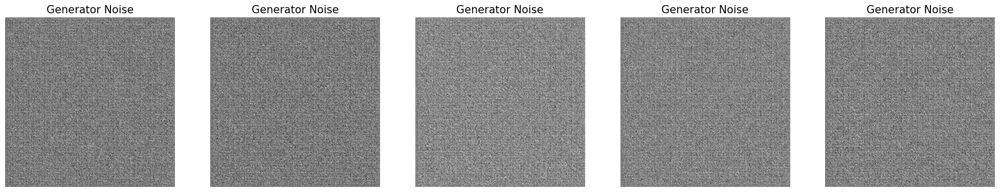

In [35]:
x_fake = g_model(noise,training=False)
pyplot.figure(figsize=(25,25))
for i in range(n_samples):
    pyplot.subplot(5, 5, 1 + i)
    pyplot.axis('off')
    pyplot.title('Generator Noise',fontsize=15)
    pyplot.imshow(x_fake[i, :, :,0],cmap='gray')
pyplot.show()
pyplot.close()

# **Test Discriminator**

In [36]:
print (x_fake.shape)

(5, 256, 256, 1)


In [37]:
d_model.predict(x_fake)

1/1 [==============================] - 0s 392ms/step


array([[2.1266686e-05],
       [3.5410030e-05],
       [1.4400980e-04],
       [7.6869241e-05],
       [2.0834742e-04]], dtype=float32)

# **Define loss functions**

In [38]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

# **Define optimisers**

In [39]:
generator_optimiser = tf.keras.optimizers.Adam(learning_rate=0.0002)

discriminator_optimiser = tf.keras.optimizers.Adam(learning_rate=0.0001)

# **Training Functions**

In [40]:
batch_size = 10

def train_step(images):
    noise = tf.random.normal([batch_size, latent_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = g_model(noise, training=True)

        real_output = d_model(images, training=True)
        fake_output = d_model(generated_images, training=True)

        g_loss = generator_loss(fake_output)
        d_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(g_loss, g_model.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(d_loss, d_model.trainable_variables)

    generator_optimiser.apply_gradients(zip(gradients_of_generator, g_model.trainable_variables))
    discriminator_optimiser.apply_gradients(zip(gradients_of_discriminator, d_model.trainable_variables))
    return g_loss,d_loss 


# **Store generator and discriminator Loss Values**

In [41]:
d_loss_history = []
g_loss_history = []

# **Training Loop**

Batch and shuffle the data

In [42]:
total_size=training_images.shape[0]
train_dataset = tf.data.Dataset.from_tensor_slices(training_images).shuffle(total_size).batch(batch_size)

Batch Per Epoch : 0/61
>0, 0/61, g=1.19512248, d=1.98834181


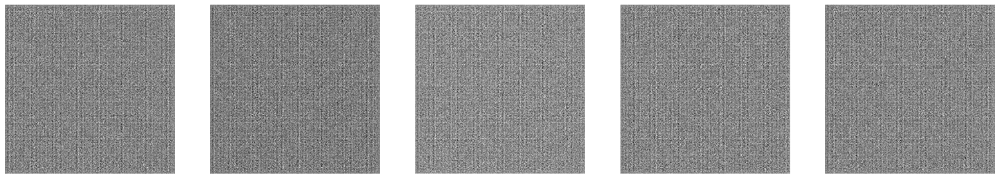

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>1, 0/61, g=5.30140257, d=0.20251746


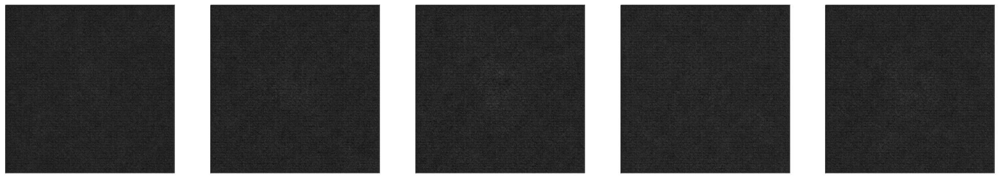

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>2, 0/61, g=3.16570711, d=0.84111160


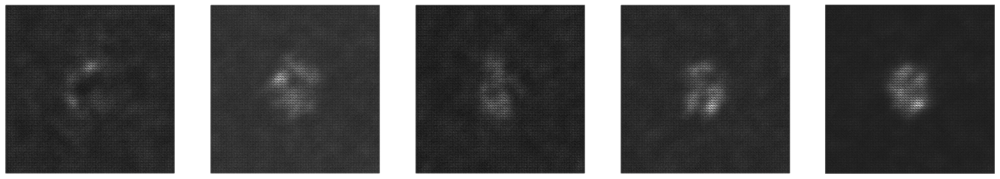

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>3, 0/61, g=1.18759310, d=0.81547081


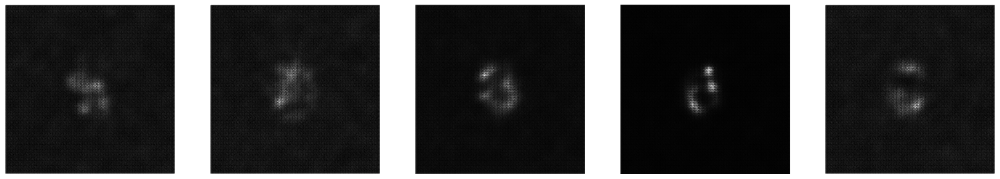

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>4, 0/61, g=1.64967191, d=0.86569941


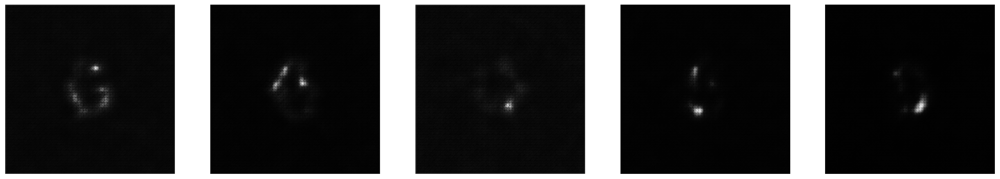

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>5, 0/61, g=1.64827061, d=0.93499380


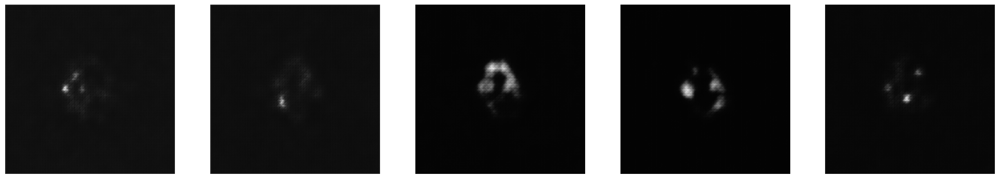

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>6, 0/61, g=1.30534780, d=1.32076752


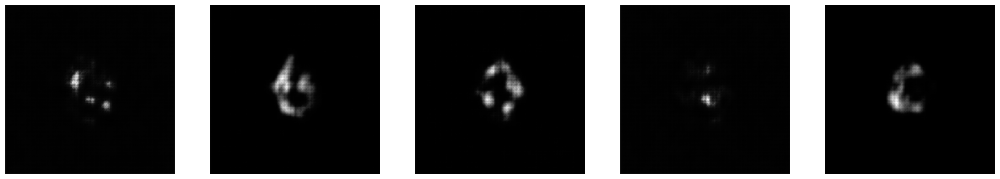

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>7, 0/61, g=2.25358391, d=1.14014983


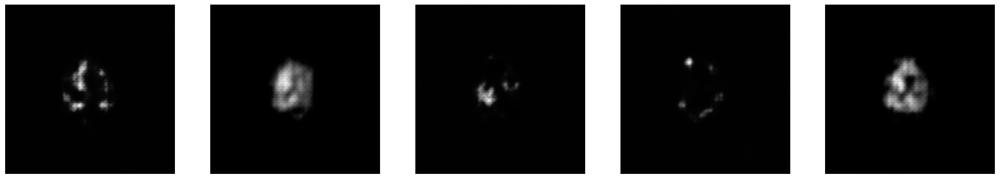

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>8, 0/61, g=1.56702530, d=1.24244499


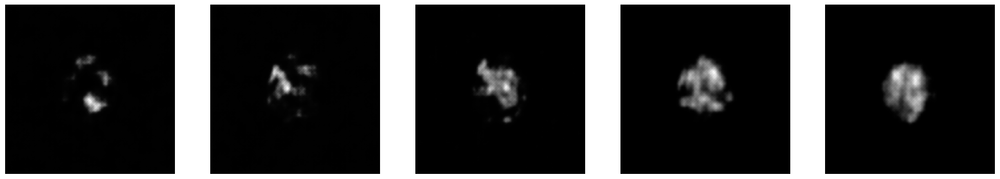

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>9, 0/61, g=1.39812529, d=1.24616230


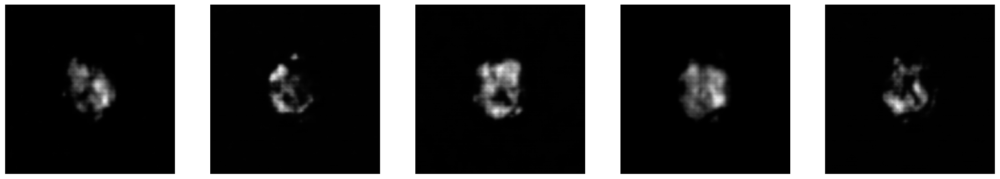

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>10, 0/61, g=1.30226922, d=0.96344411


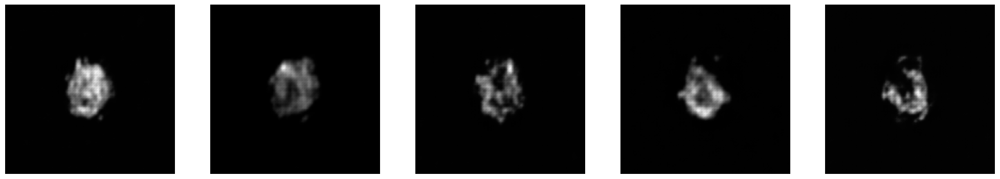

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>11, 0/61, g=1.09471011, d=1.68244028


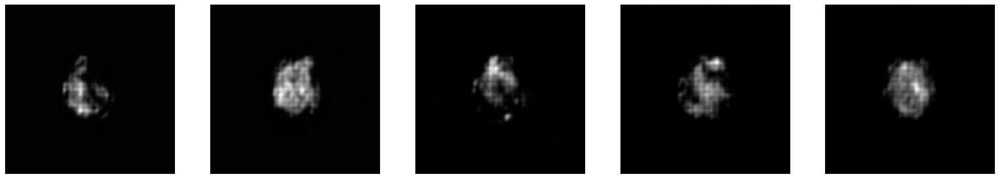

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>12, 0/61, g=1.21135235, d=1.06685936


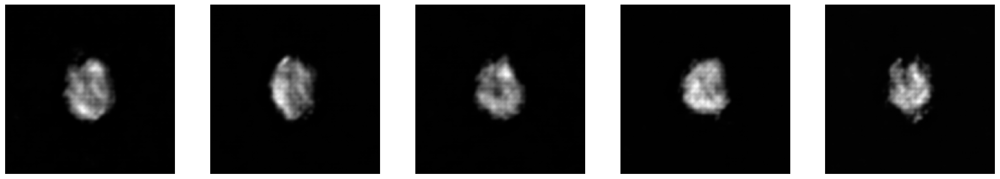

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>13, 0/61, g=1.73968410, d=1.09141552


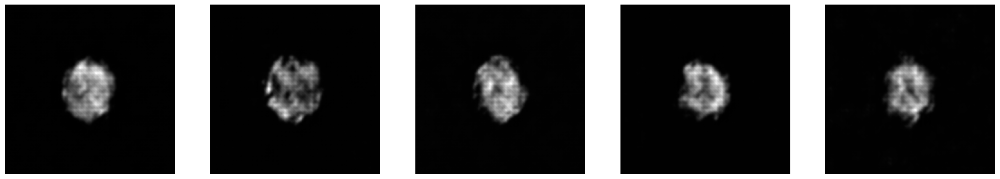

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>14, 0/61, g=1.01864183, d=1.46065211


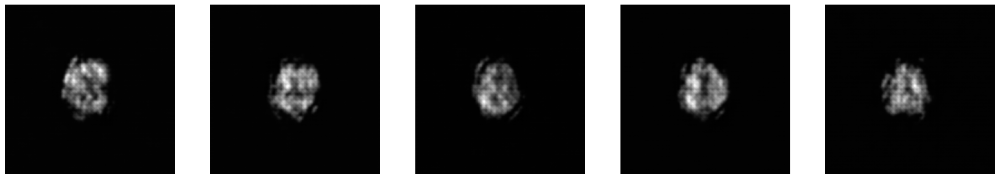

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>15, 0/61, g=1.26187325, d=1.50922811


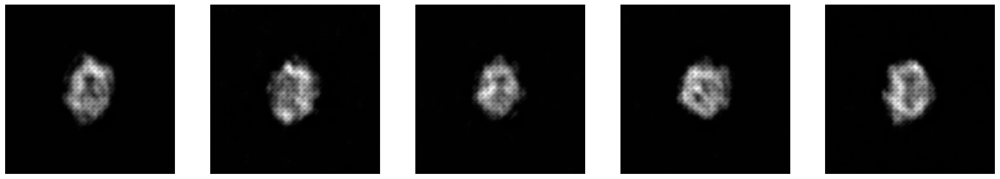

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>16, 0/61, g=1.70453382, d=1.32398486


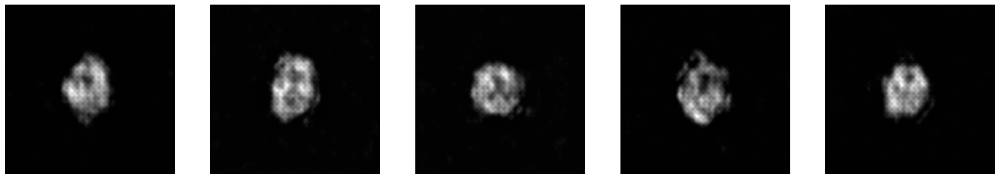

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>17, 0/61, g=0.92511493, d=1.42166901


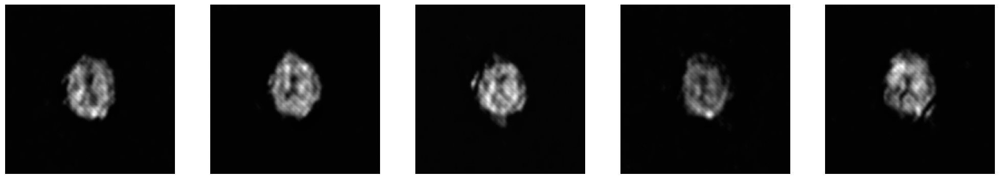

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>18, 0/61, g=2.86336207, d=1.72332704


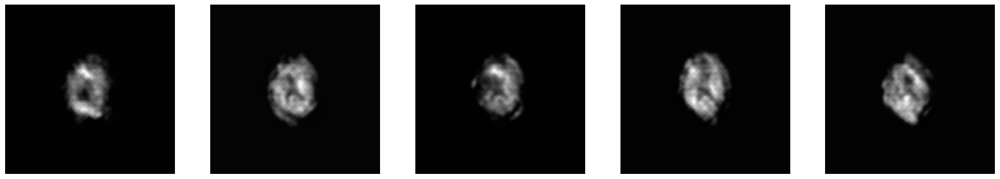

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>19, 0/61, g=0.56262332, d=1.81674504


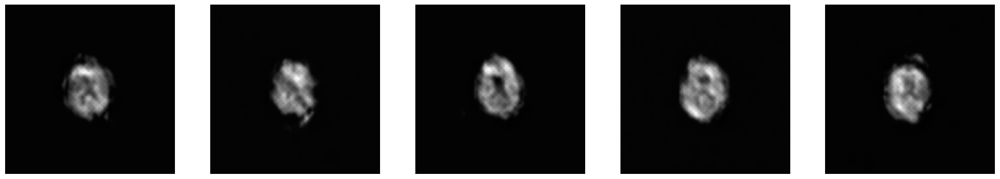

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>20, 0/61, g=0.85256654, d=1.30659366


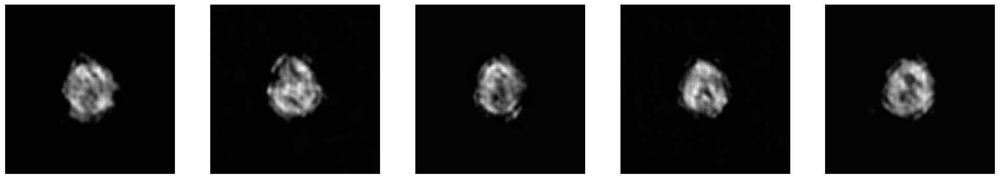

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>21, 0/61, g=1.96815526, d=1.04014111


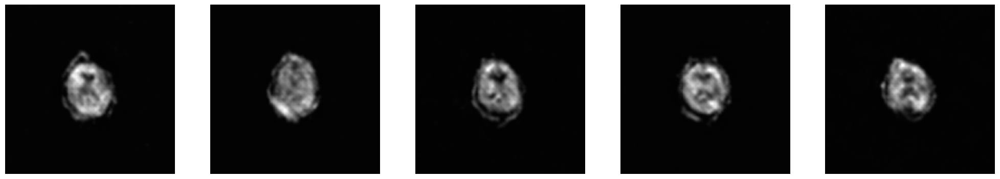

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>22, 0/61, g=1.00656104, d=1.43305087


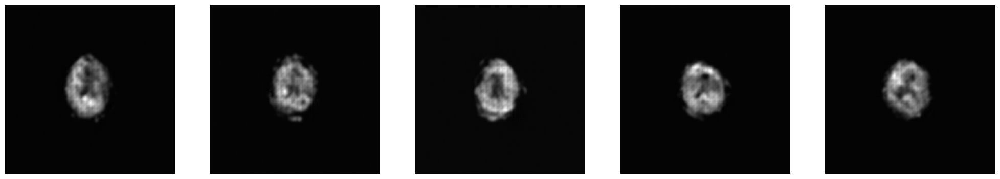

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>23, 0/61, g=0.84824008, d=1.44000697


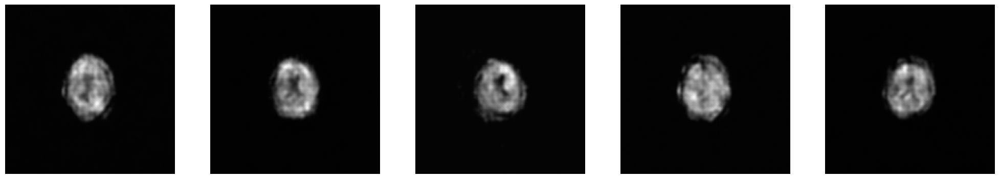

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>24, 0/61, g=1.24916244, d=1.24376810


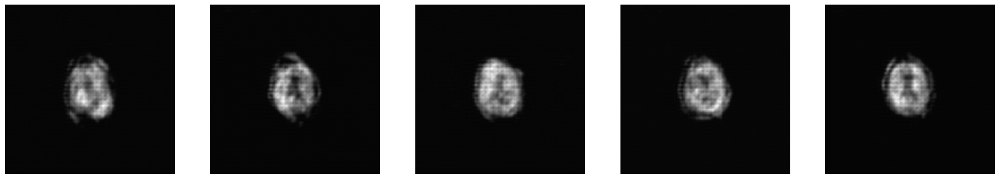

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>25, 0/61, g=1.29436278, d=1.21593988


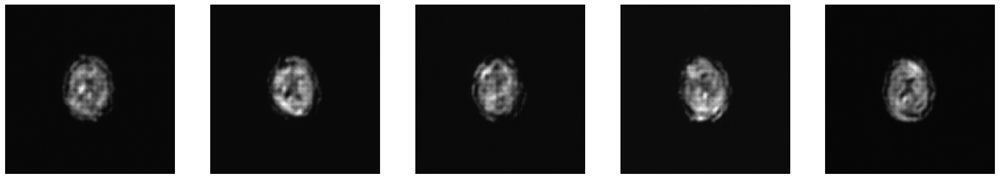

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>26, 0/61, g=1.24974799, d=1.51939583


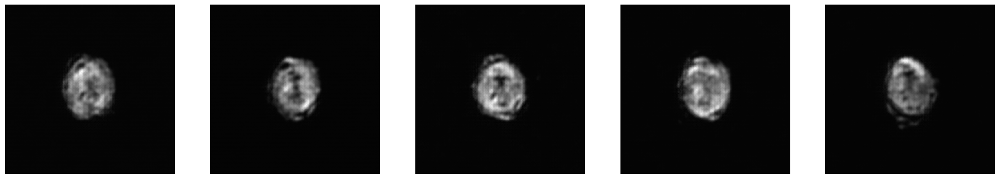

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>27, 0/61, g=1.12075365, d=1.47505474


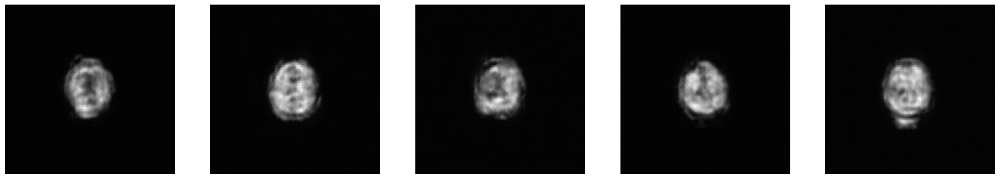

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>28, 0/61, g=0.67181182, d=1.82714128


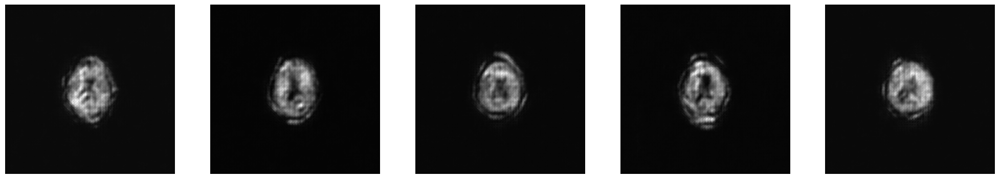

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>29, 0/61, g=1.02661729, d=1.43640709


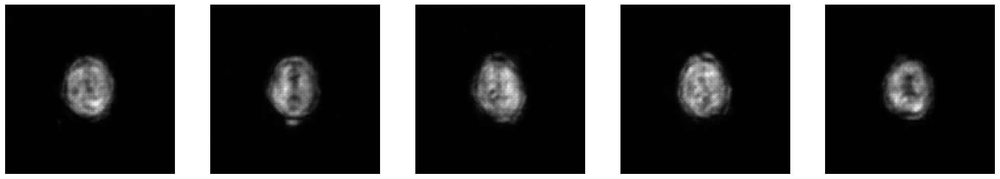

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>30, 0/61, g=1.14405608, d=1.17027974


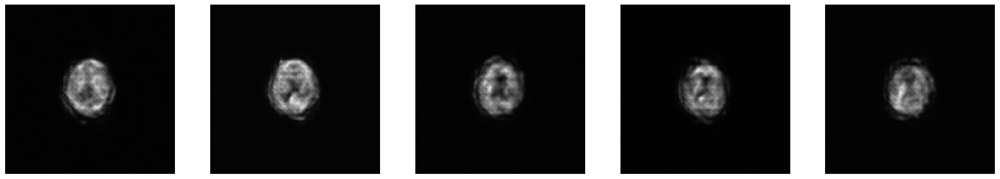

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>31, 0/61, g=0.88350946, d=1.56604266


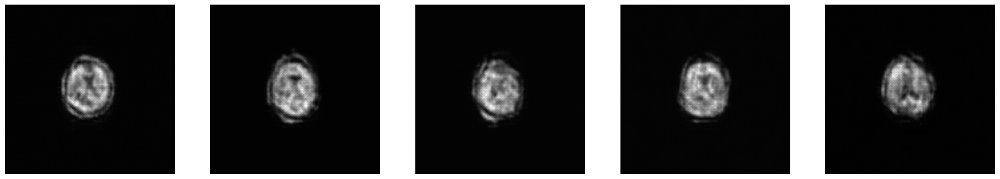

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>32, 0/61, g=0.60964143, d=1.95062125


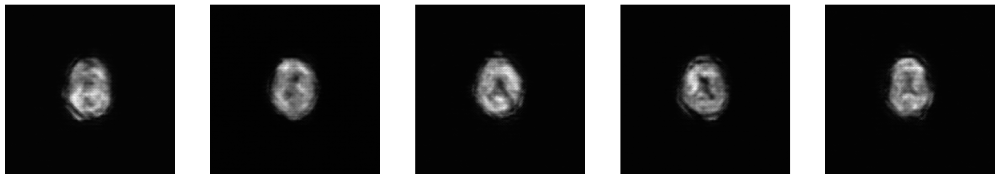

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>33, 0/61, g=0.76555884, d=1.42962921


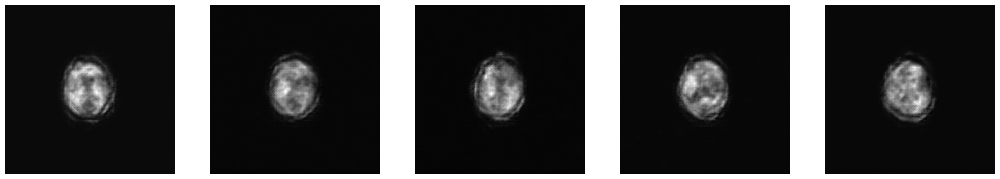

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>34, 0/61, g=1.39319968, d=1.44494462


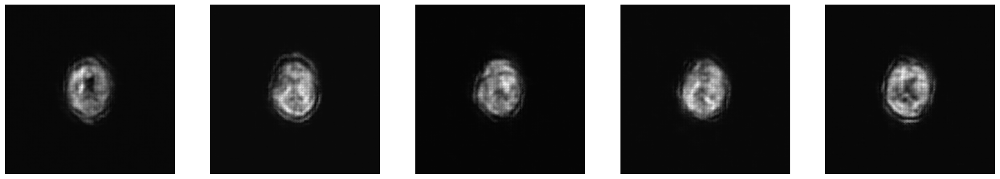

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>35, 0/61, g=0.75123292, d=1.60166526


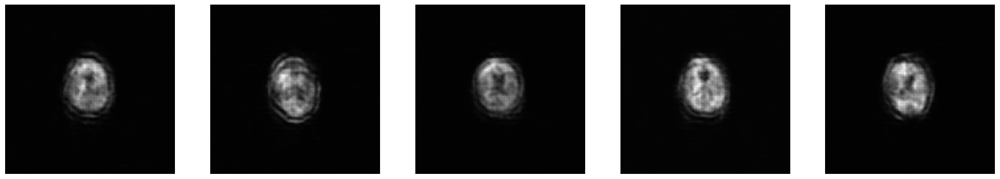

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>36, 0/61, g=0.76404649, d=1.70018876


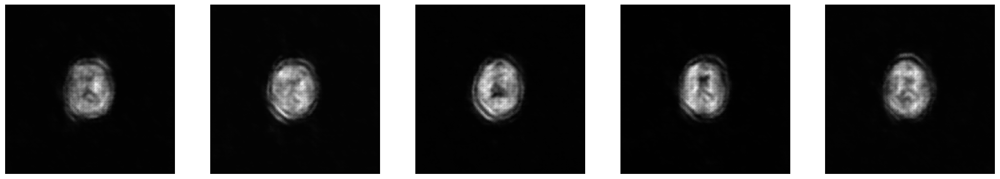

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>37, 0/61, g=0.68861622, d=1.67340171


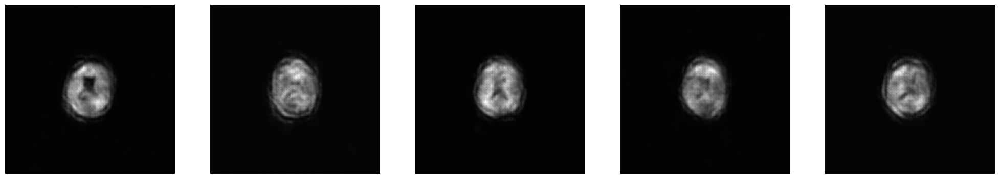

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>38, 0/61, g=0.95764780, d=1.81849194


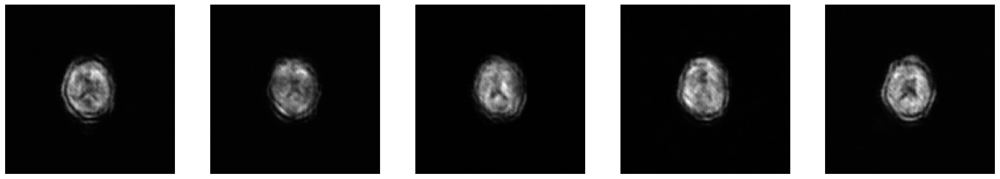

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>39, 0/61, g=1.33343744, d=1.22517586


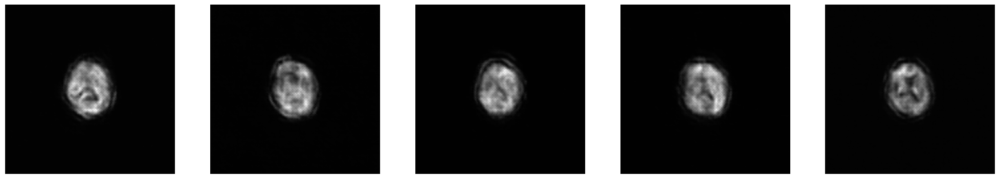

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>40, 0/61, g=0.80799466, d=1.44342971


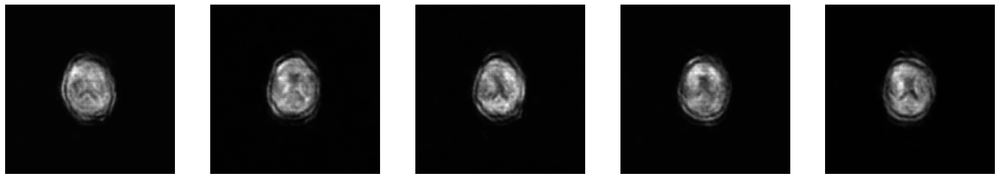

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>41, 0/61, g=0.69838554, d=1.45799243


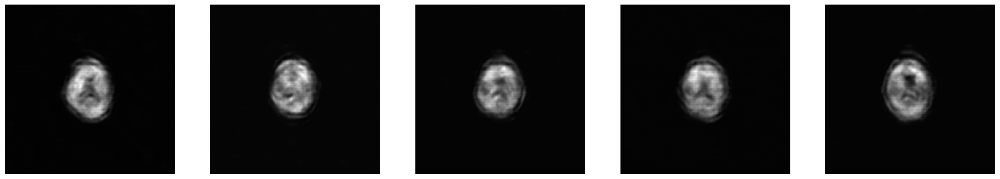

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>42, 0/61, g=0.75630832, d=1.67786741


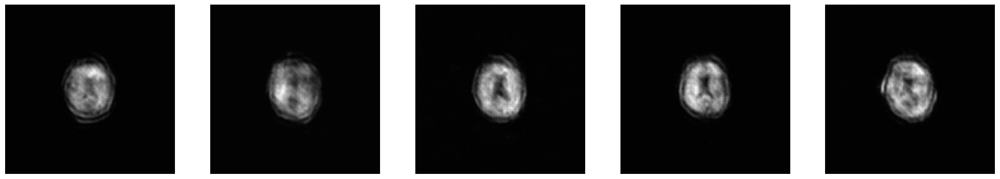

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>43, 0/61, g=0.73373330, d=1.46177185


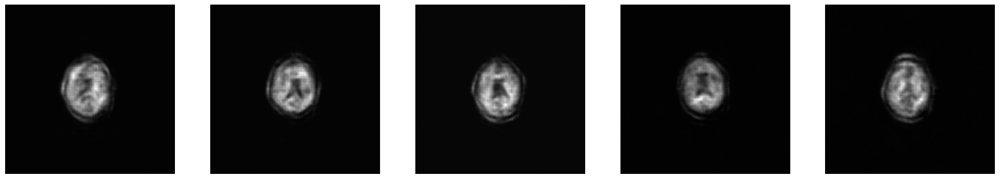

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>44, 0/61, g=1.13980615, d=1.98854351


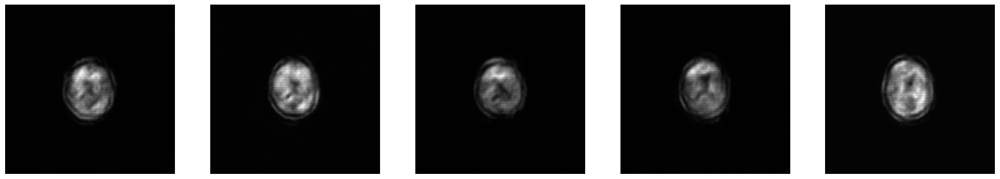

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>45, 0/61, g=0.83866006, d=1.75884616


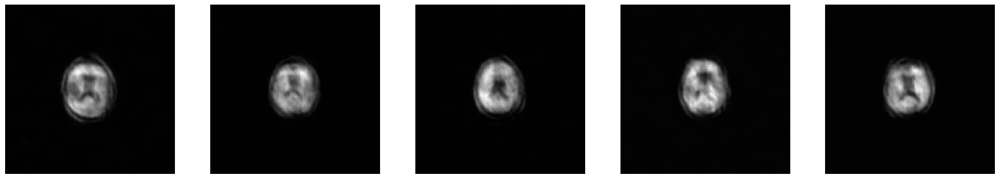

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>46, 0/61, g=1.02359307, d=1.29672897


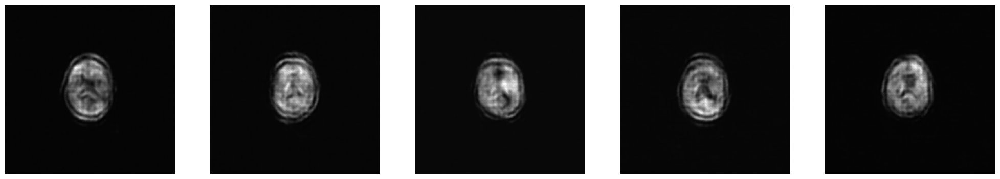

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>47, 0/61, g=0.90837508, d=1.25200176


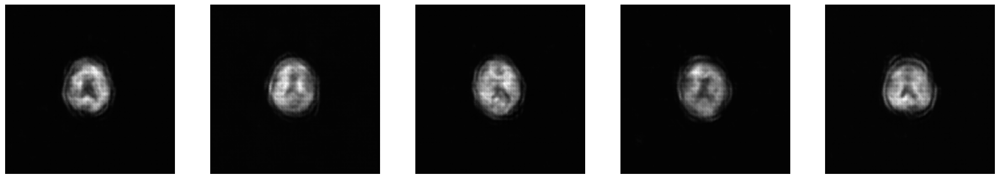

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>48, 0/61, g=0.84092867, d=1.29498613


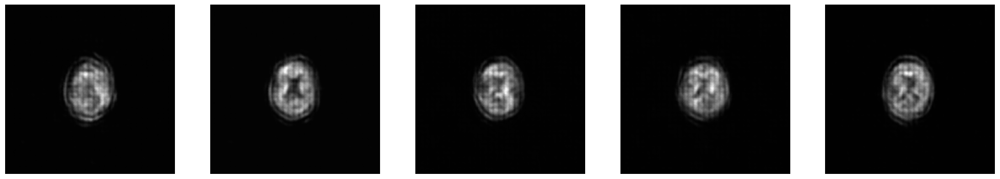

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>49, 0/61, g=1.06881058, d=1.27640796


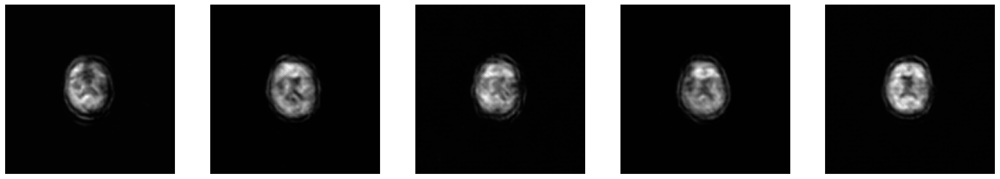

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>50, 0/61, g=0.86548585, d=1.18441808


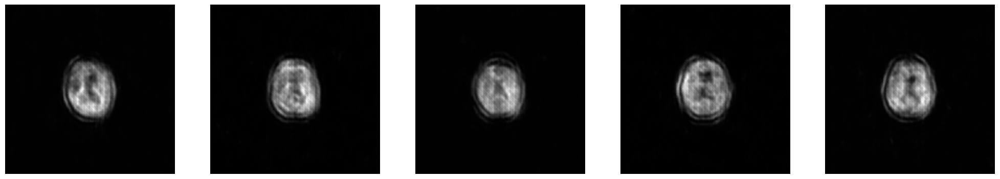

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>51, 0/61, g=0.95897639, d=1.38823080


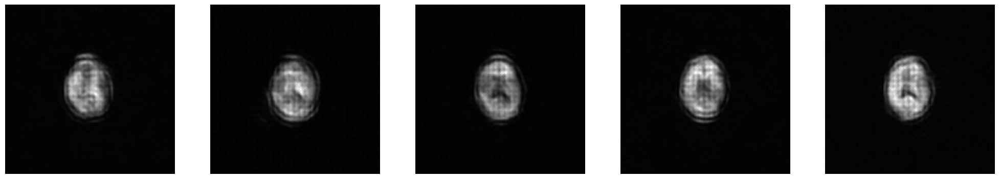

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>52, 0/61, g=0.79375207, d=1.66415083


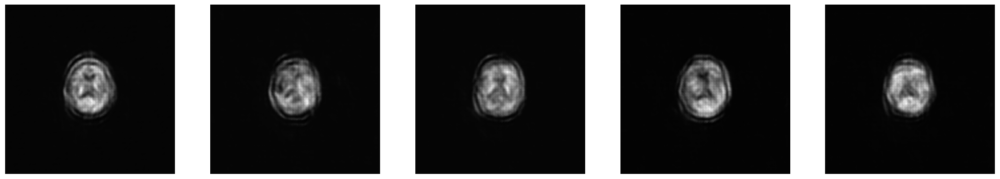

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>53, 0/61, g=0.75113845, d=1.19831109


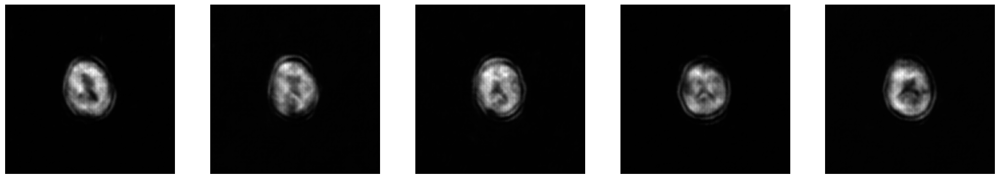

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>54, 0/61, g=0.95312130, d=1.24422860


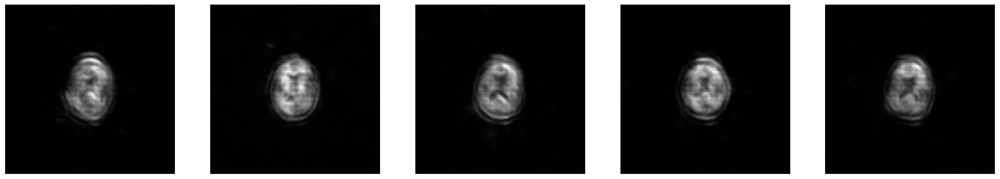

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>55, 0/61, g=0.98238075, d=1.16201162


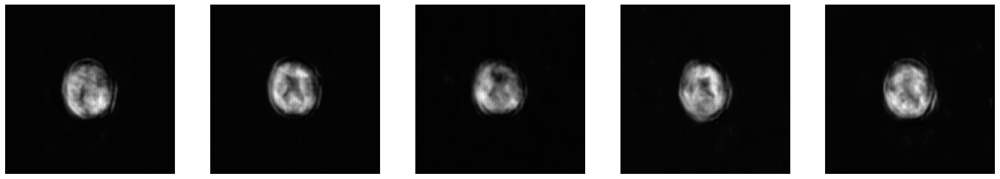

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>56, 0/61, g=0.65736932, d=1.17691970


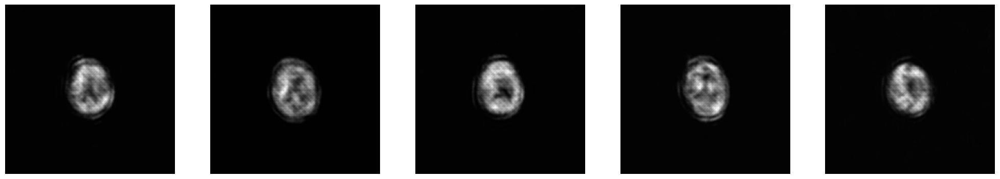

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>57, 0/61, g=1.01943779, d=2.01854277


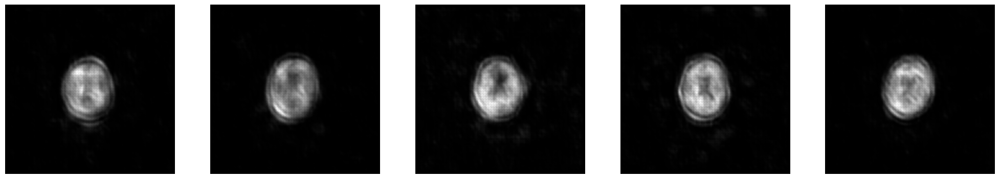

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>58, 0/61, g=0.68142694, d=1.58312345


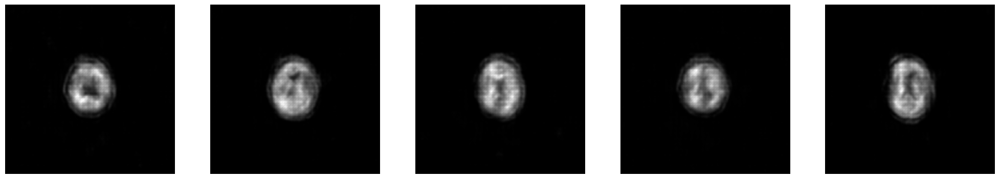

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>59, 0/61, g=0.77214801, d=1.45083380


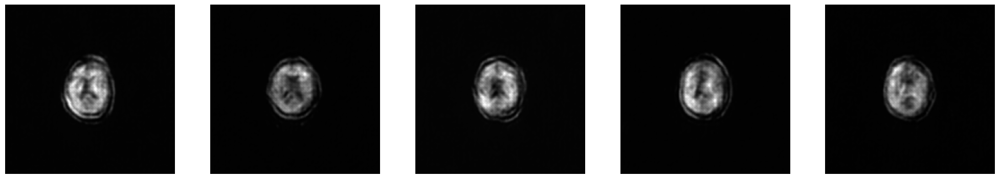

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>60, 0/61, g=0.92779845, d=1.35045350


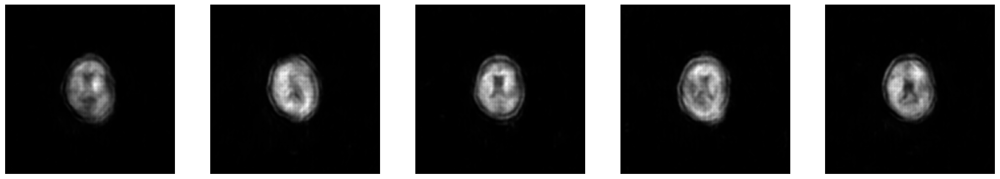

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>61, 0/61, g=1.08165717, d=1.28679121


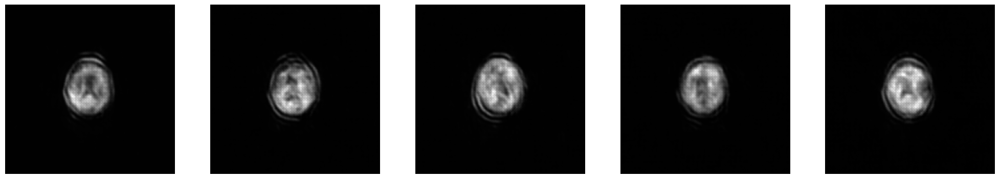

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>62, 0/61, g=0.87825584, d=1.26919234


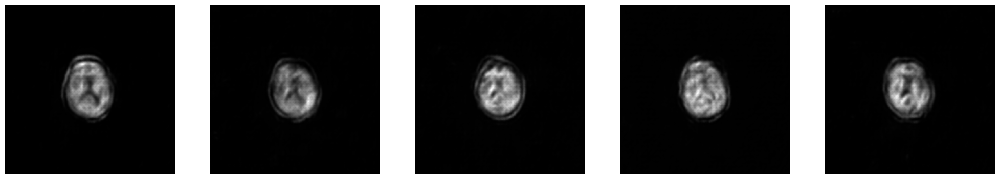

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>63, 0/61, g=0.99991256, d=1.31751800


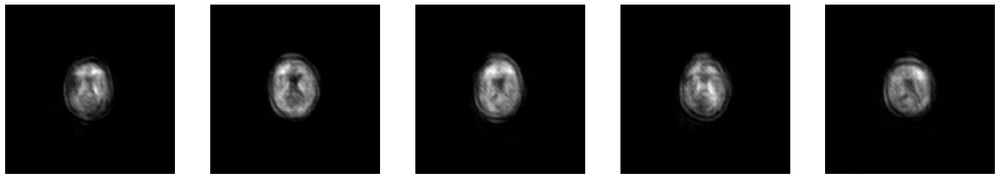

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>64, 0/61, g=0.82205218, d=1.29243946


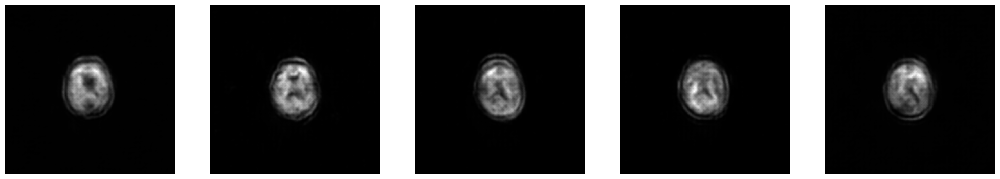

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>65, 0/61, g=0.90576136, d=1.38147330


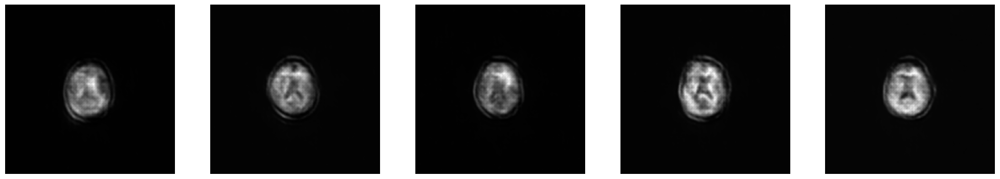

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>66, 0/61, g=0.94912577, d=1.59583426


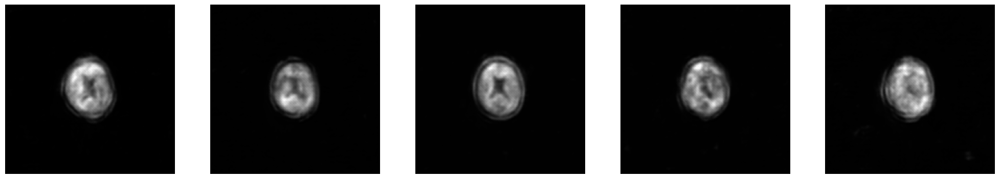

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>67, 0/61, g=0.76982808, d=1.36641514


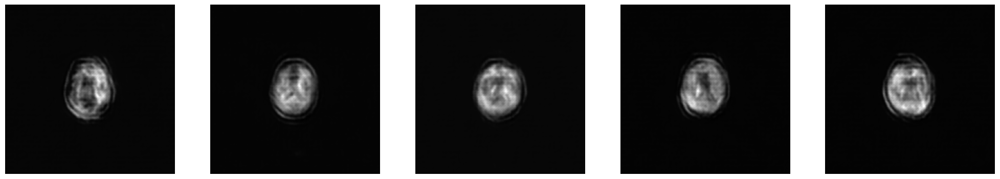

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>68, 0/61, g=0.61545765, d=1.52472329


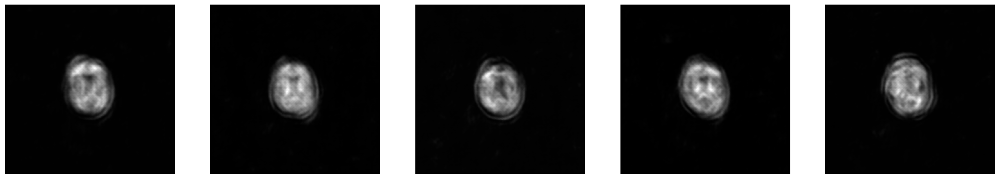

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>69, 0/61, g=0.93830073, d=1.74225724


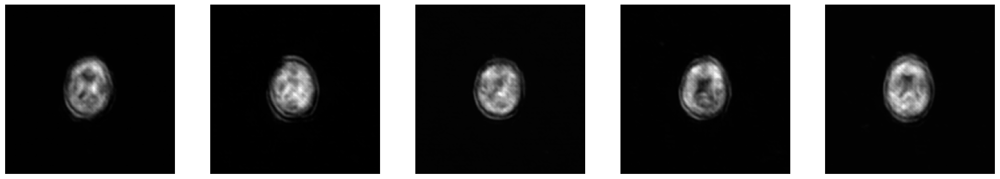

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>70, 0/61, g=0.86052960, d=1.18215418


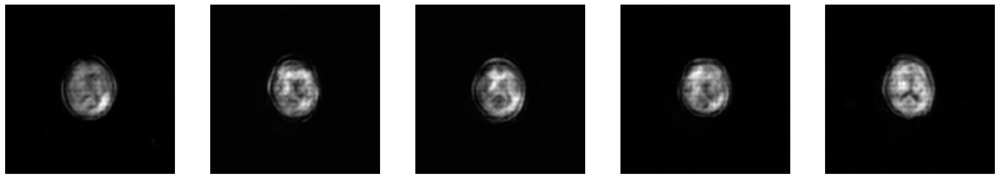

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>71, 0/61, g=0.65935475, d=1.73396385


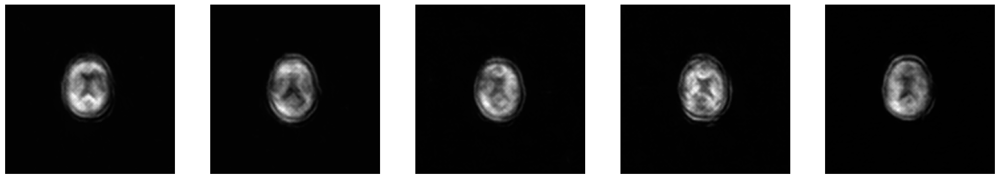

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>72, 0/61, g=0.98331547, d=1.25549507


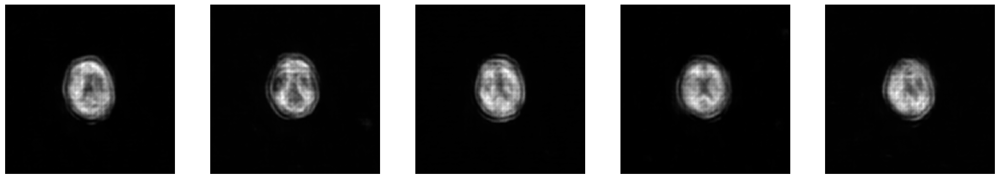

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>73, 0/61, g=1.18342054, d=1.18454218


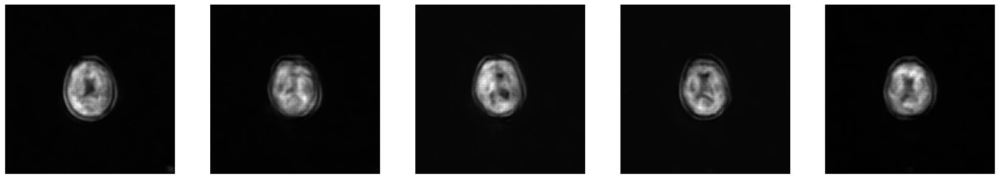

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>74, 0/61, g=0.88053066, d=1.51934218


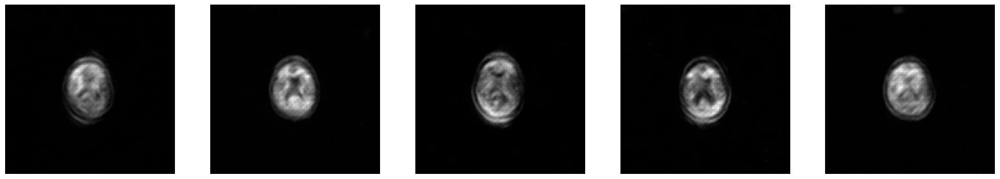

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>75, 0/61, g=0.78539807, d=1.61576462


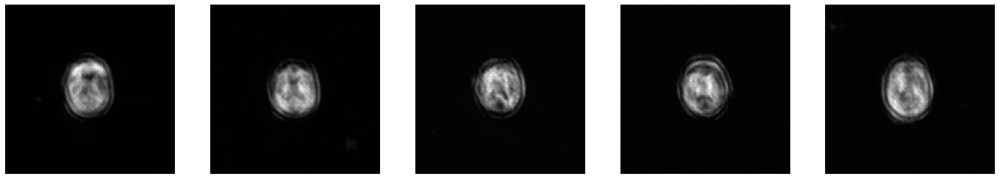

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>76, 0/61, g=1.40805745, d=1.07189989


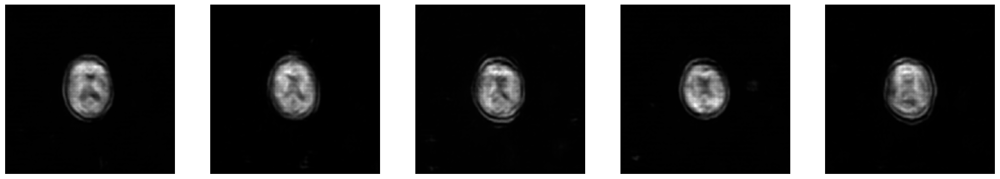

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>77, 0/61, g=1.26815963, d=1.04171610


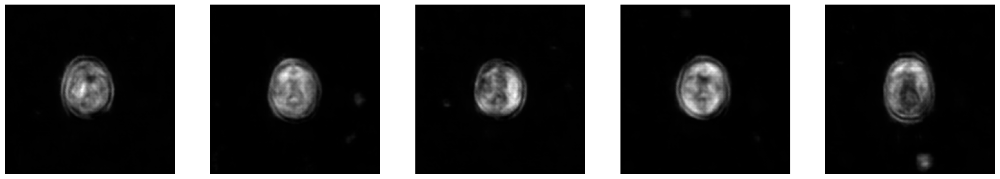

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>78, 0/61, g=0.67715728, d=1.14853108


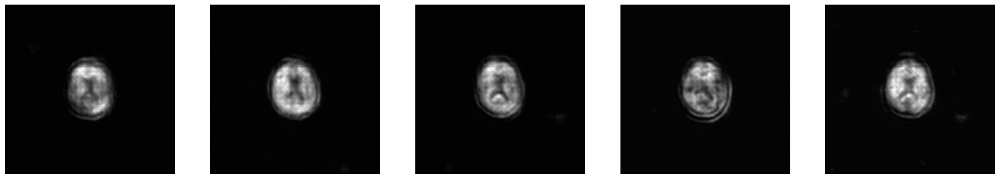

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>79, 0/61, g=0.99354631, d=1.26774001


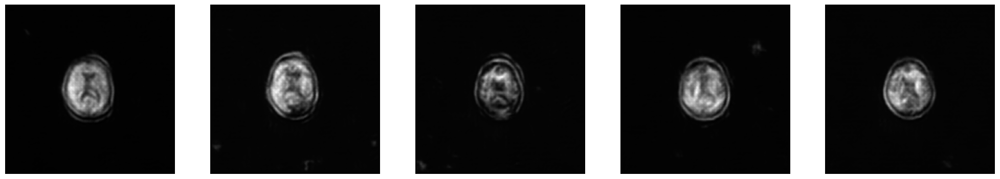

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>80, 0/61, g=1.37743890, d=0.81276160


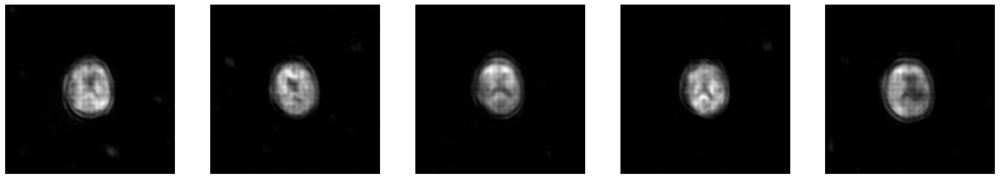

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>81, 0/61, g=0.88626468, d=1.30191922


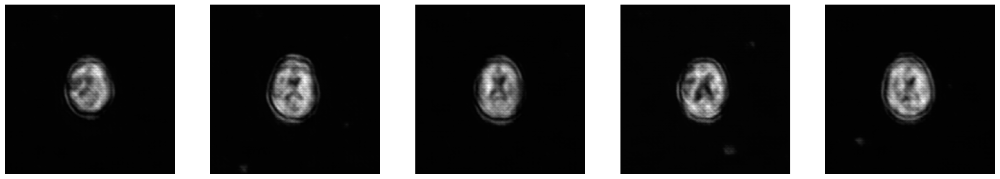

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>82, 0/61, g=1.59093535, d=1.51138663


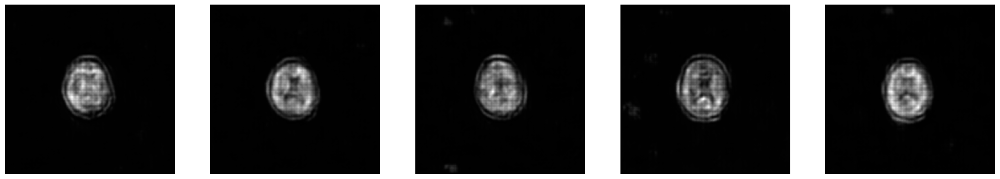

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>83, 0/61, g=0.81970882, d=1.42960799


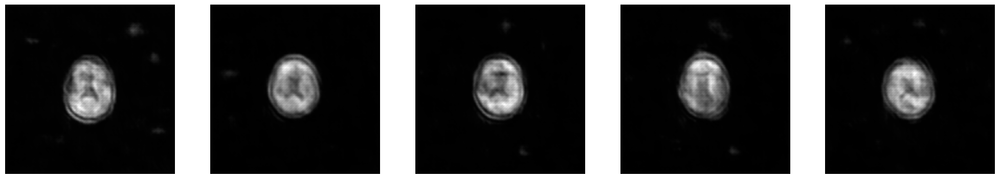

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>84, 0/61, g=0.90052682, d=1.31770980


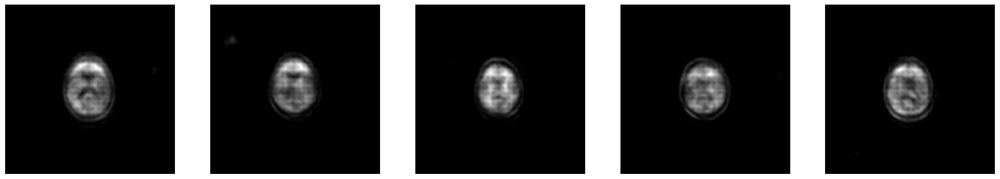

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>85, 0/61, g=0.92685163, d=1.38076687


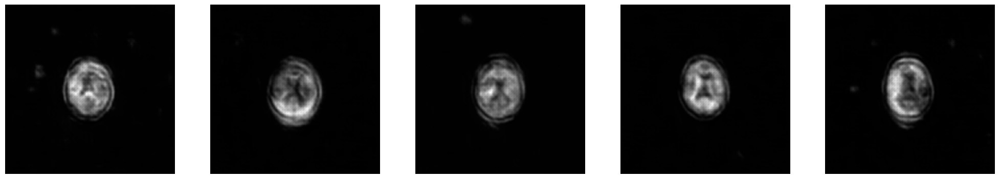

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>86, 0/61, g=1.50889432, d=1.17351937


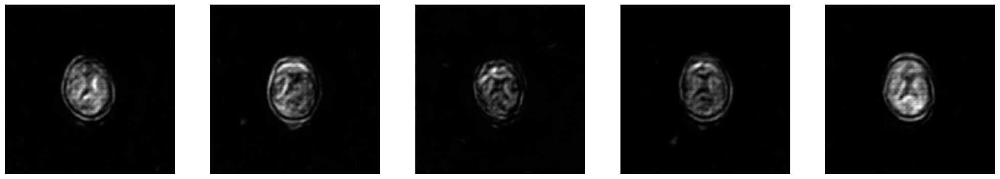

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>87, 0/61, g=1.80499232, d=1.22504210


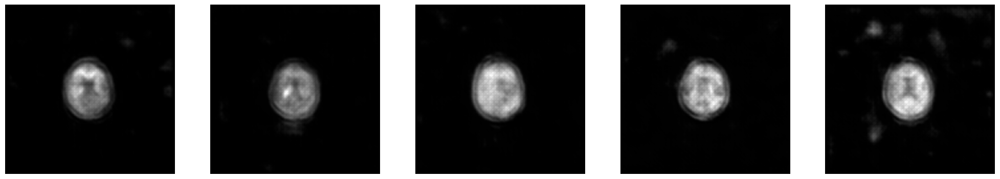

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>88, 0/61, g=0.94839448, d=1.51482177


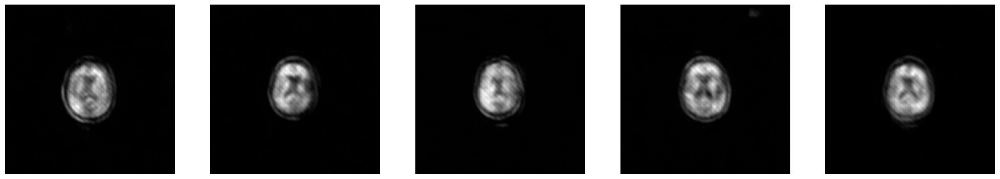

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>89, 0/61, g=0.99979895, d=1.46644342


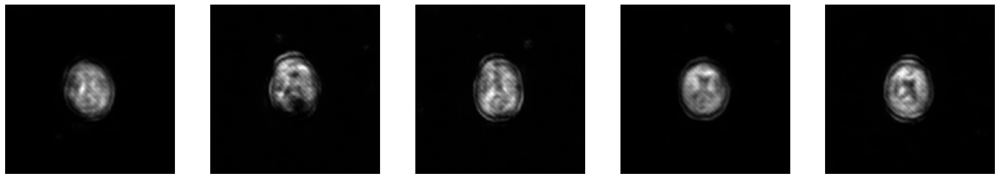

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>90, 0/61, g=2.00851059, d=0.60064548


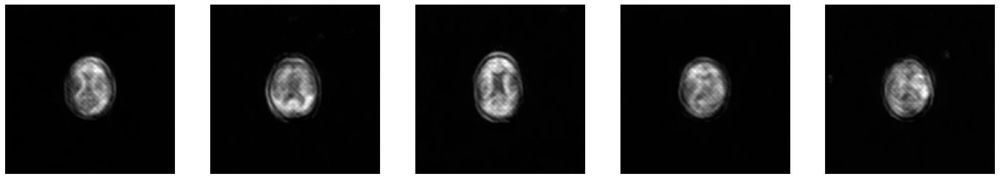

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>91, 0/61, g=0.84486187, d=1.18168664


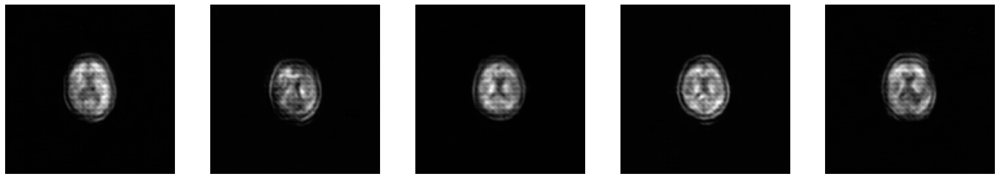

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>92, 0/61, g=1.36189389, d=0.88839042


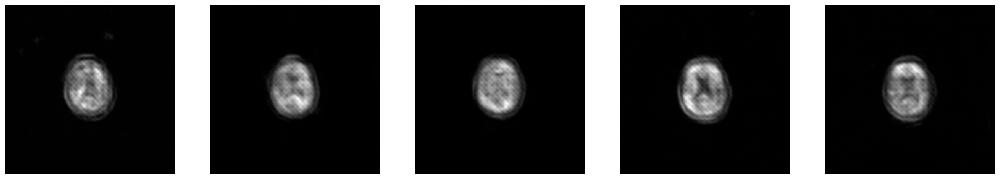

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>93, 0/61, g=1.26755834, d=1.04298806


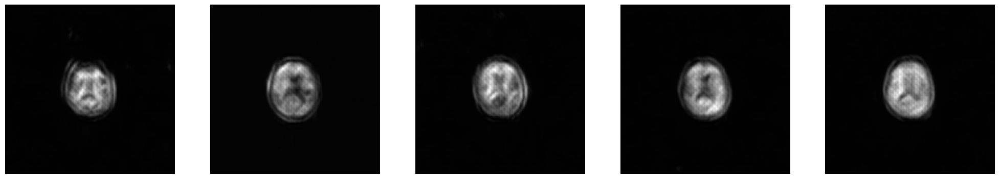

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>94, 0/61, g=1.25244510, d=1.26570344


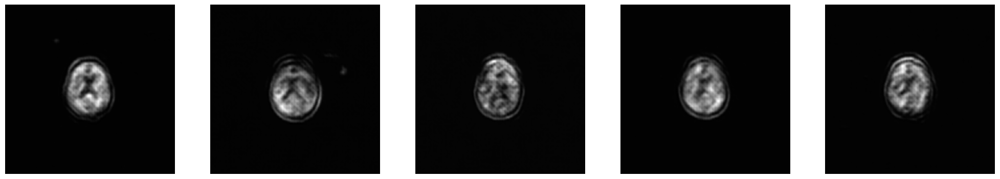

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>95, 0/61, g=1.14695191, d=0.92524505


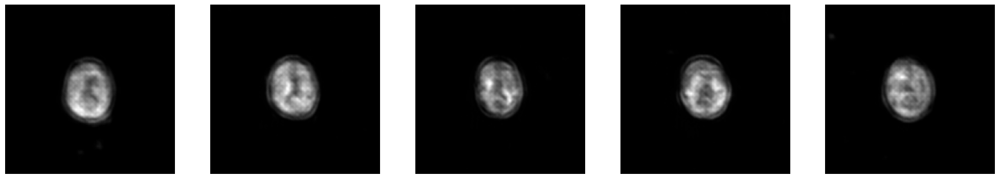

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>96, 0/61, g=1.42716002, d=0.68502432


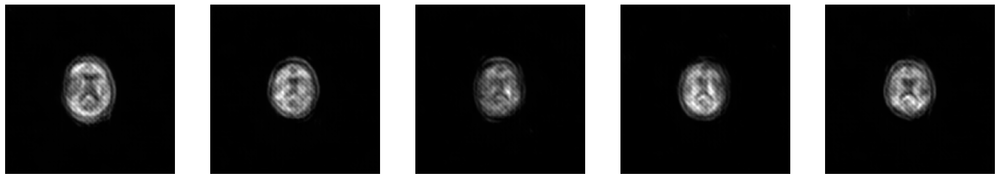

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>97, 0/61, g=1.18578231, d=1.04392588


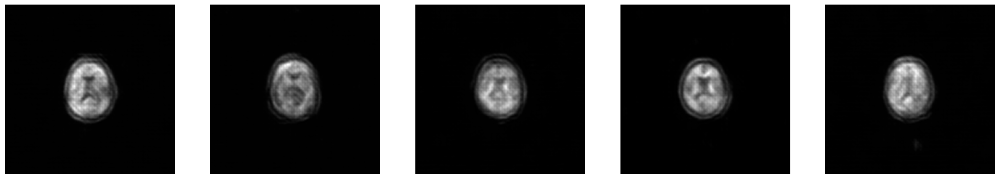

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>98, 0/61, g=1.36188650, d=1.21370995


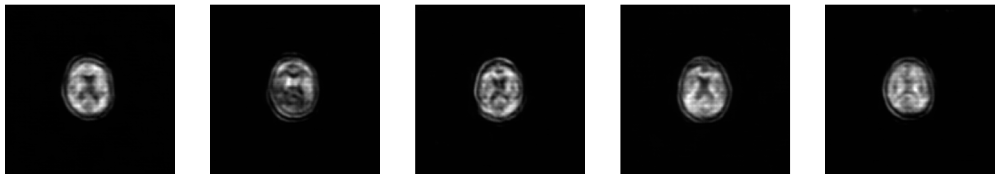

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>99, 0/61, g=0.39591801, d=1.85387754


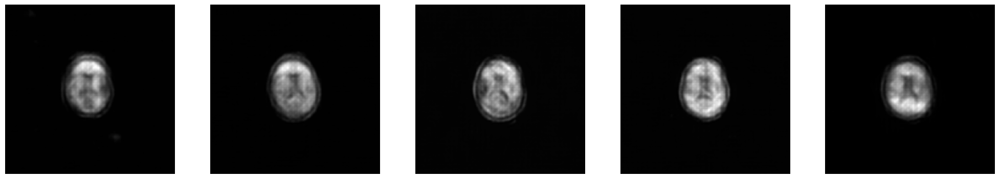

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>100, 0/61, g=1.43045270, d=0.85752684


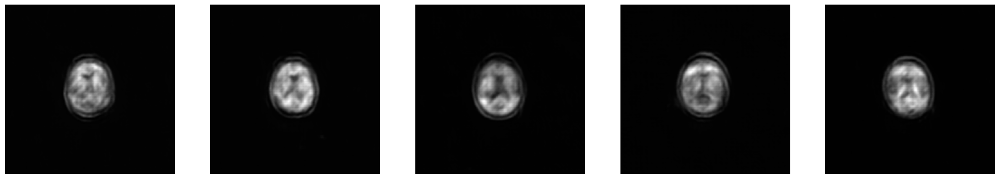

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>101, 0/61, g=0.91831863, d=1.16502309


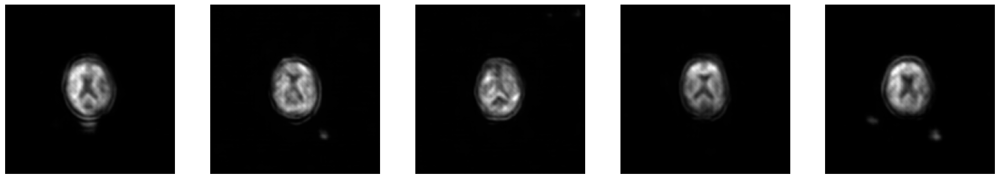

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>102, 0/61, g=1.06485939, d=0.98983610


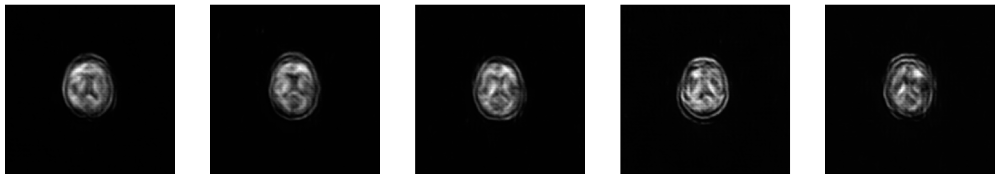

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>103, 0/61, g=0.32894582, d=2.35338116


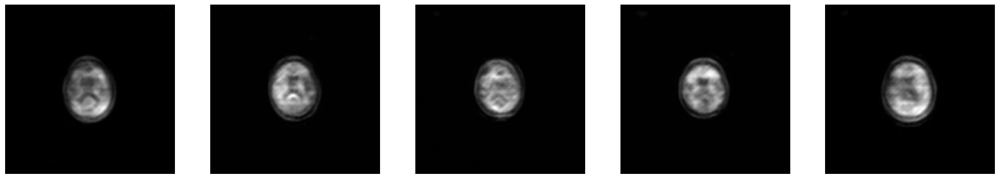

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>104, 0/61, g=1.03136599, d=0.95535457


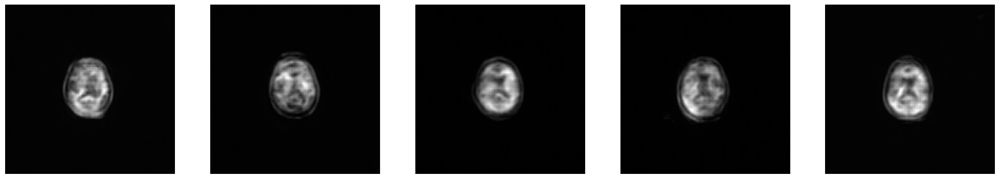

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>105, 0/61, g=1.02473974, d=1.38697028


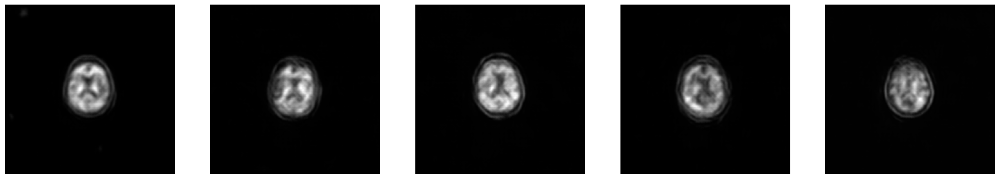

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>106, 0/61, g=0.62885094, d=1.27195549


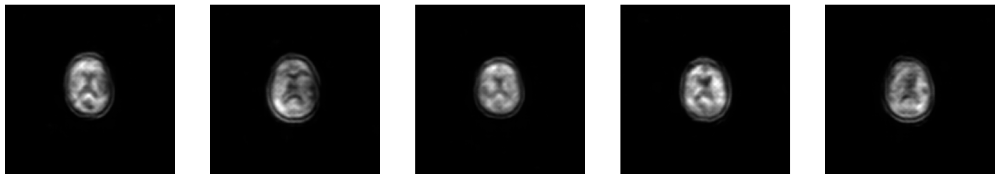

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>107, 0/61, g=1.60331404, d=0.93431193


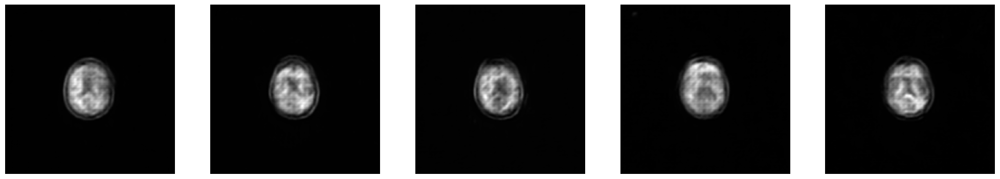

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>108, 0/61, g=0.98178148, d=1.42663336


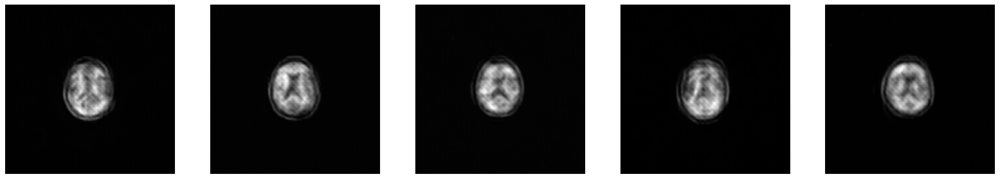

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>109, 0/61, g=0.95151216, d=1.26935995


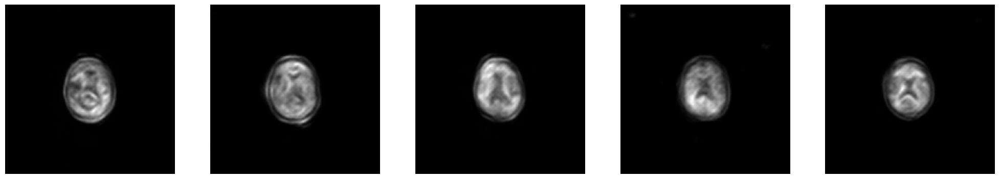

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>110, 0/61, g=0.75403571, d=1.62848282


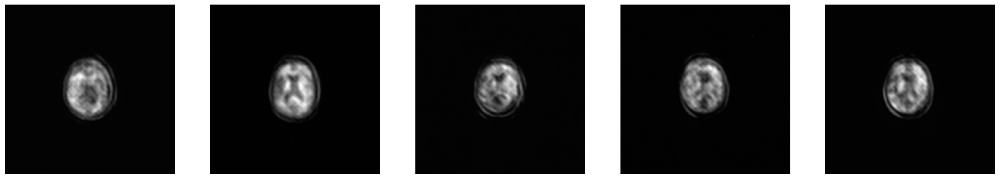

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>111, 0/61, g=0.68345207, d=1.39701033


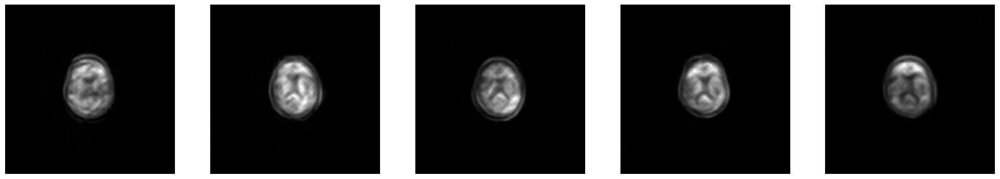

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>112, 0/61, g=1.25390649, d=1.29093671


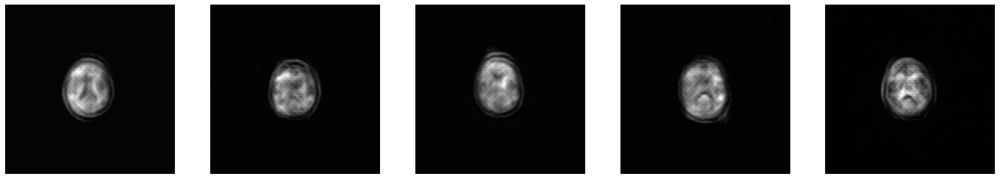

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>113, 0/61, g=0.85385722, d=1.10595036


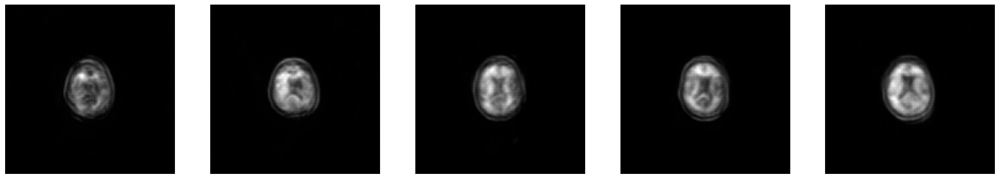

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>114, 0/61, g=0.90925473, d=1.60721481


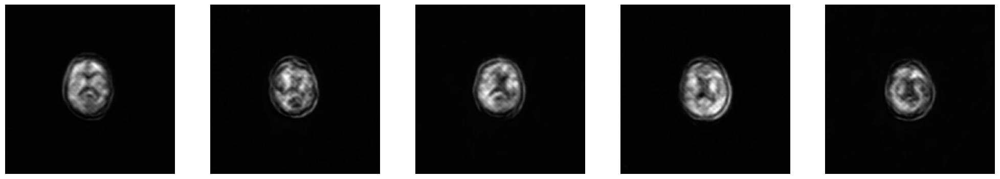

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>115, 0/61, g=0.88588226, d=1.04571533


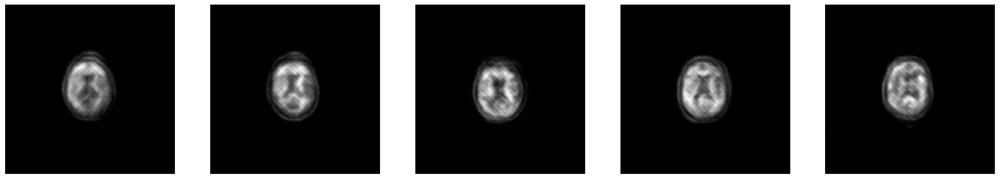

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>116, 0/61, g=0.91833001, d=1.26251352


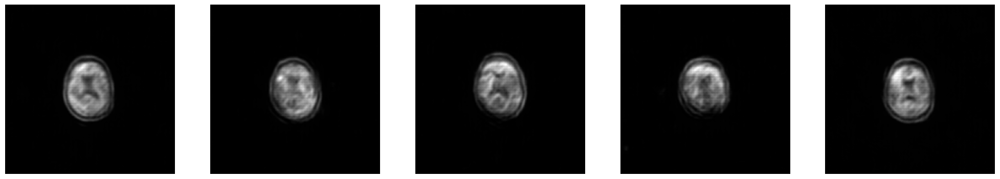

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>117, 0/61, g=1.20912683, d=0.90199405


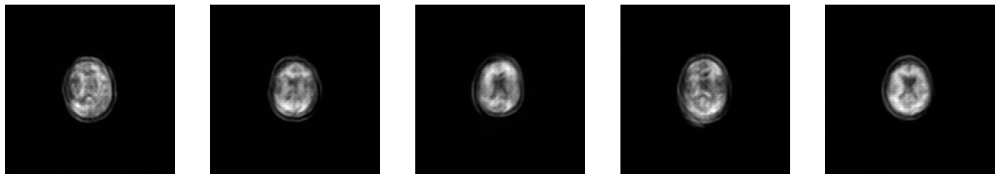

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>118, 0/61, g=0.96755660, d=1.40648055


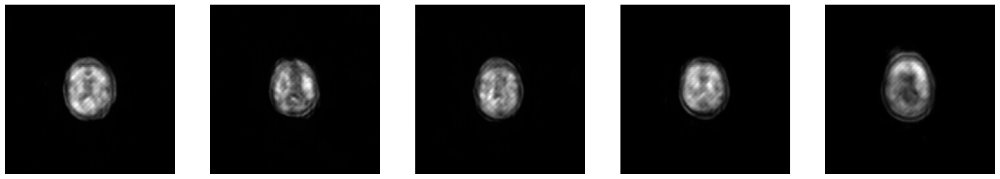

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>119, 0/61, g=0.87694991, d=1.15570188


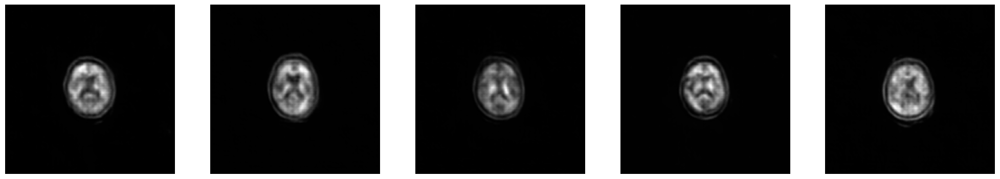

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>120, 0/61, g=1.16079986, d=1.34336030


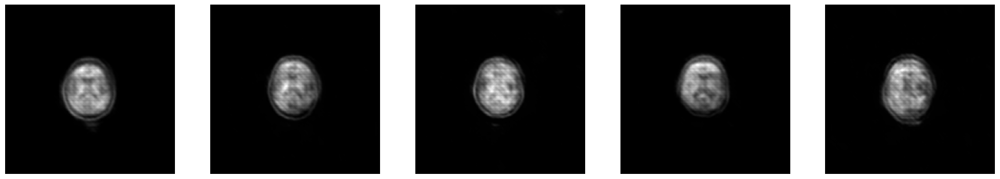

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>121, 0/61, g=1.19460332, d=1.01048577


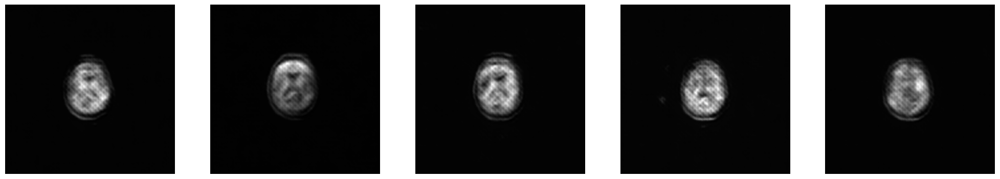

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>122, 0/61, g=1.52135491, d=0.99713665


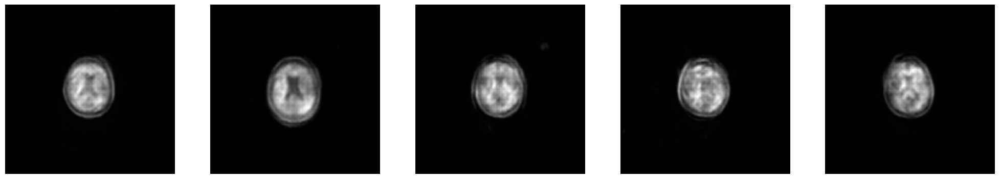

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>123, 0/61, g=1.33877897, d=1.29800570


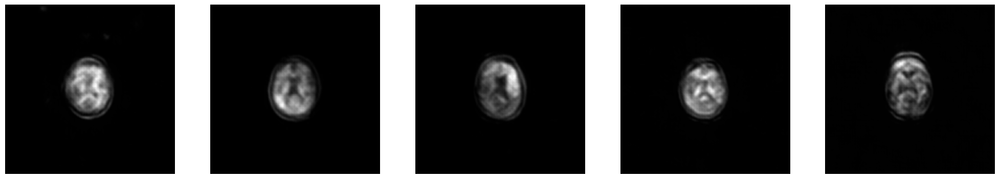

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>124, 0/61, g=0.89405572, d=1.20112693


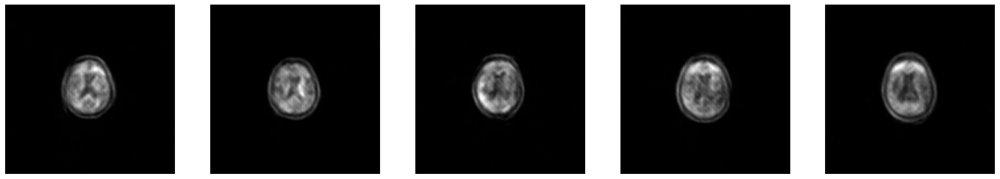

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>125, 0/61, g=1.52312529, d=0.72186041


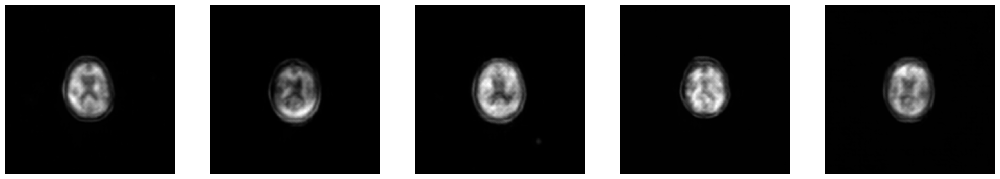

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>126, 0/61, g=1.25710833, d=1.45434737


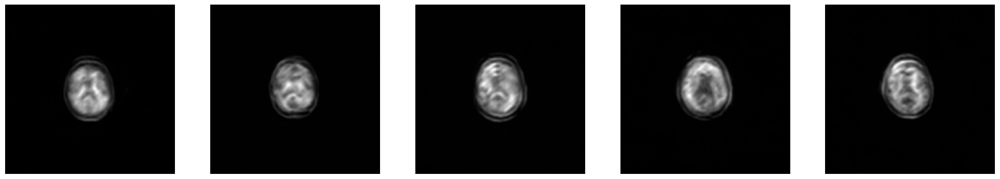

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>127, 0/61, g=0.98461932, d=1.39227164


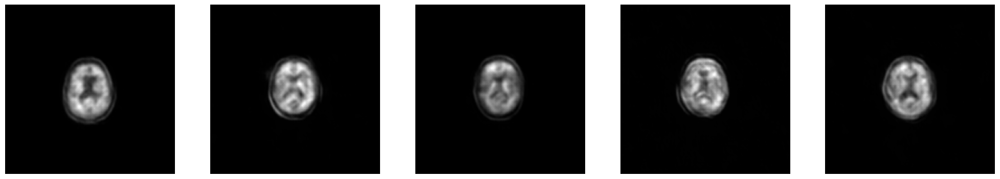

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>128, 0/61, g=1.07932460, d=1.37198353


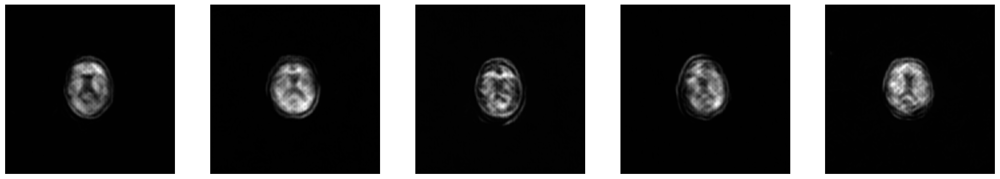

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>129, 0/61, g=1.34232664, d=0.79338574


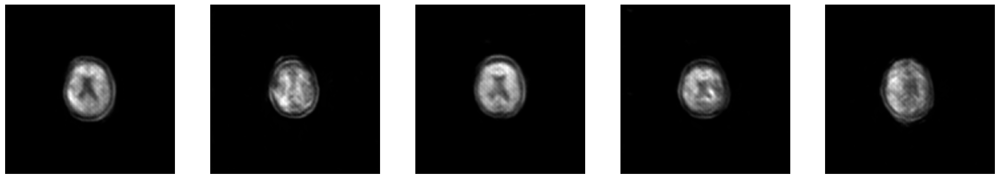

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>130, 0/61, g=1.08291125, d=0.94204187


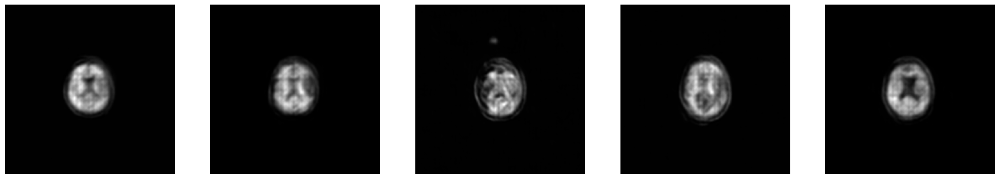

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>131, 0/61, g=0.68661439, d=1.41026878


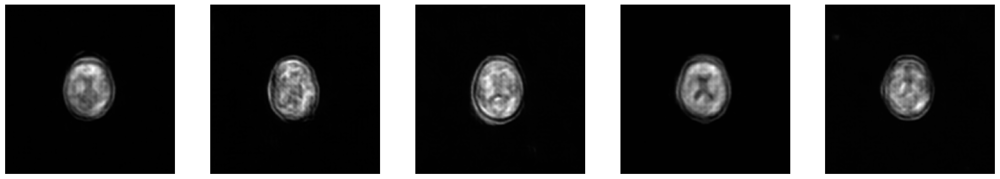

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>132, 0/61, g=1.48399508, d=0.80770290


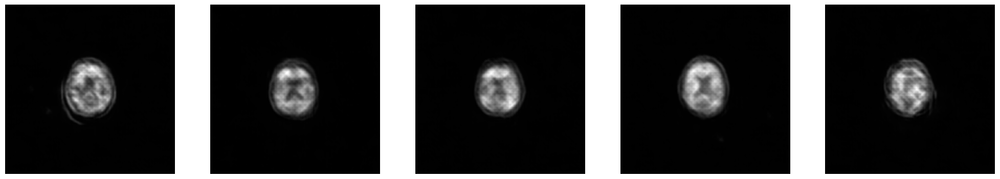

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>133, 0/61, g=0.89569205, d=1.95053768


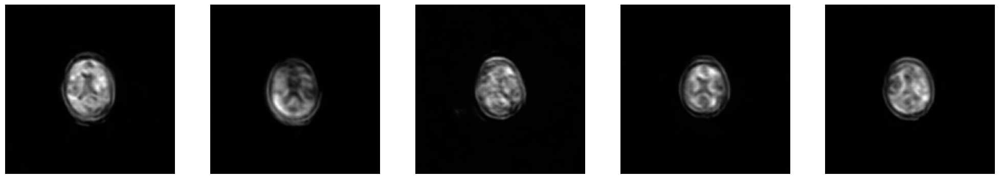

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>134, 0/61, g=0.92153990, d=1.46571302


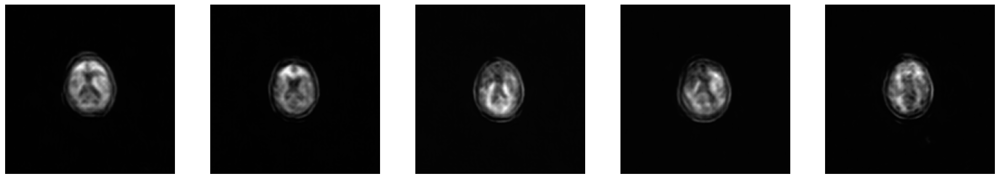

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>135, 0/61, g=1.24880755, d=0.91012585


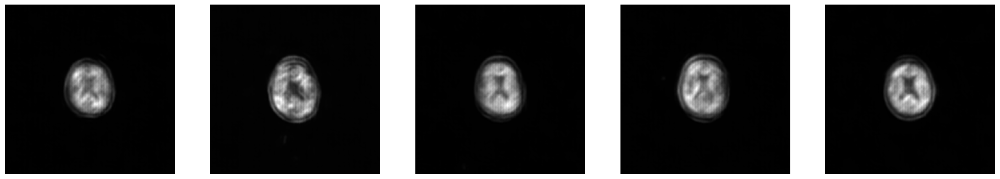

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>136, 0/61, g=1.85876119, d=0.74025404


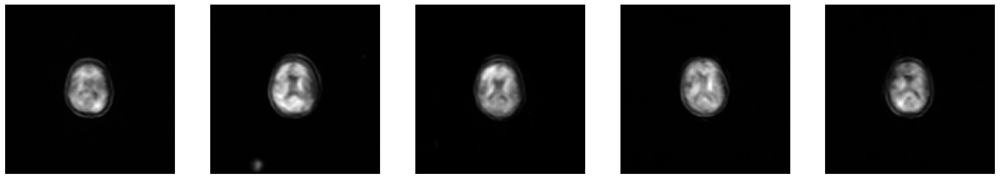

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>137, 0/61, g=1.49749815, d=0.97029728


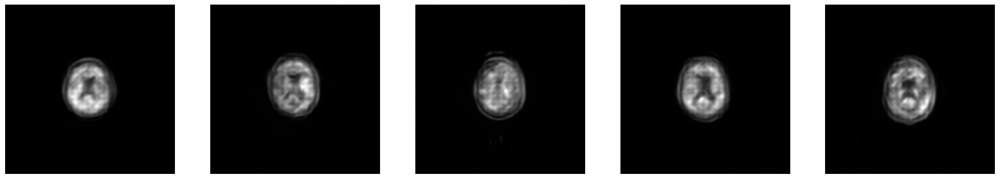

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>138, 0/61, g=1.88019311, d=0.57275069


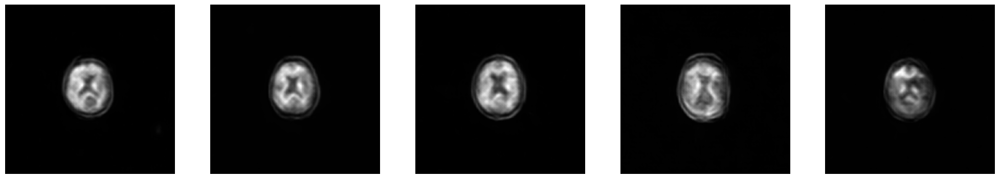

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>139, 0/61, g=1.70357478, d=0.87426412


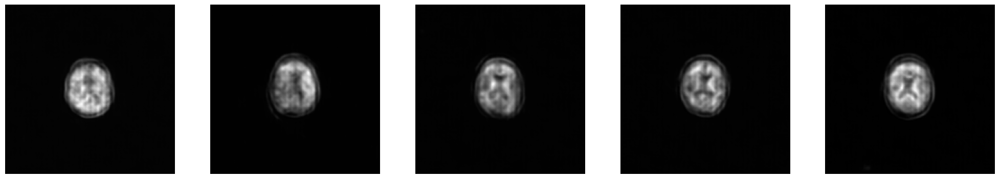

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>140, 0/61, g=0.97369993, d=1.27504432


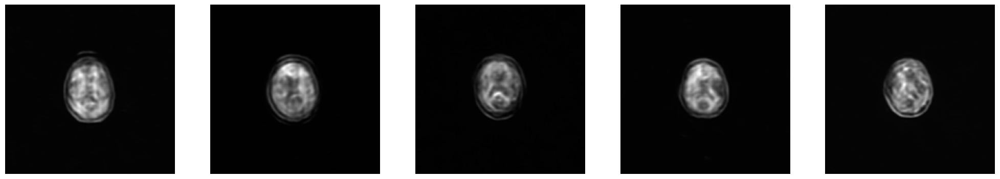

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>141, 0/61, g=0.59967339, d=1.45113802


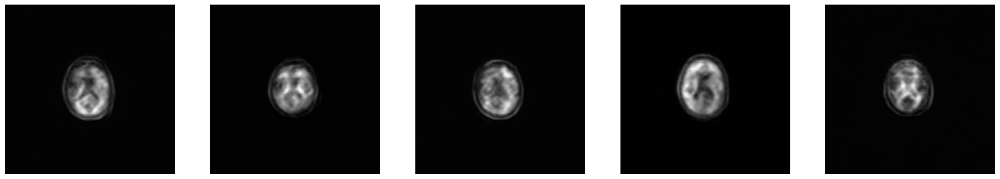

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>142, 0/61, g=0.51407588, d=2.01987696


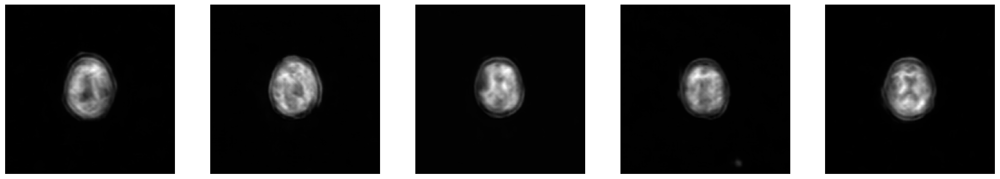

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>143, 0/61, g=1.44047809, d=0.96456289


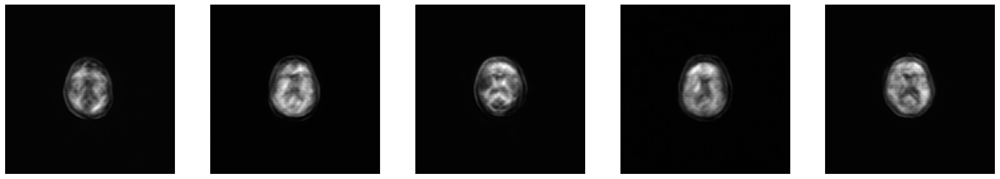

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>144, 0/61, g=1.07107341, d=1.24752593


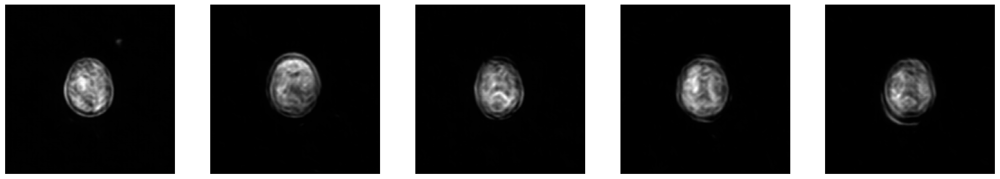

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>145, 0/61, g=1.07839942, d=1.18297315


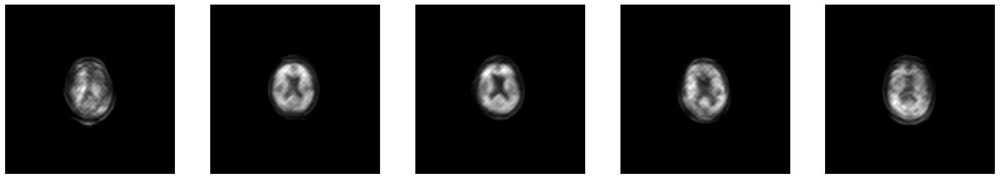

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>146, 0/61, g=1.01069367, d=1.07119918


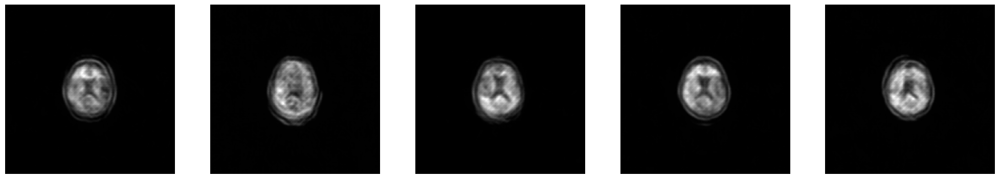

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>147, 0/61, g=0.91147614, d=1.40967274


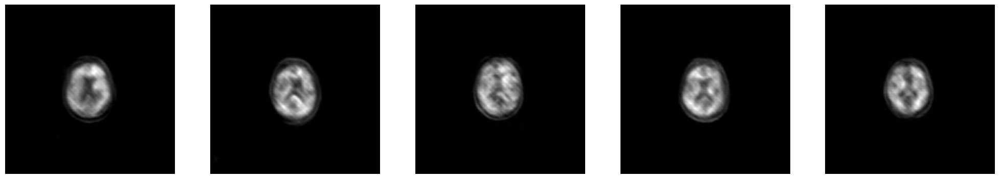

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>148, 0/61, g=1.94682813, d=0.74441314


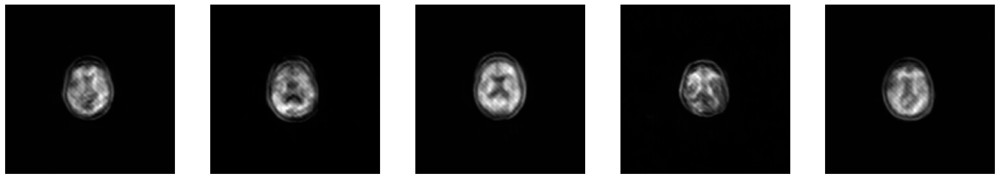

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>149, 0/61, g=1.36022019, d=1.17422700


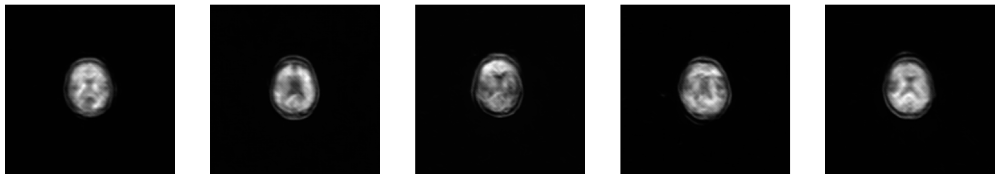

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>150, 0/61, g=1.09240568, d=0.89315116


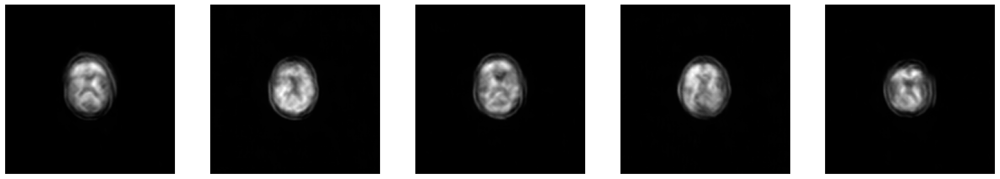

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>151, 0/61, g=0.86868060, d=1.07962728


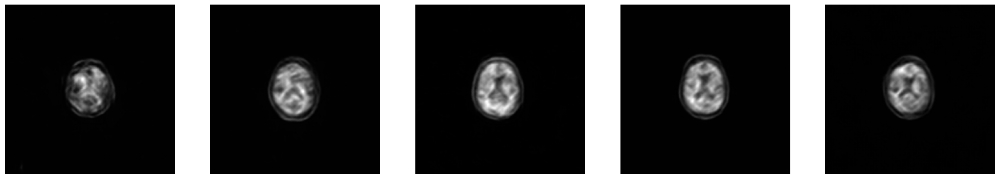

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>152, 0/61, g=1.70175624, d=0.74215913


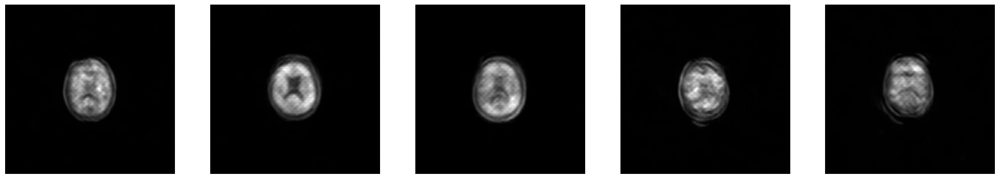

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>153, 0/61, g=1.39257085, d=0.83325410


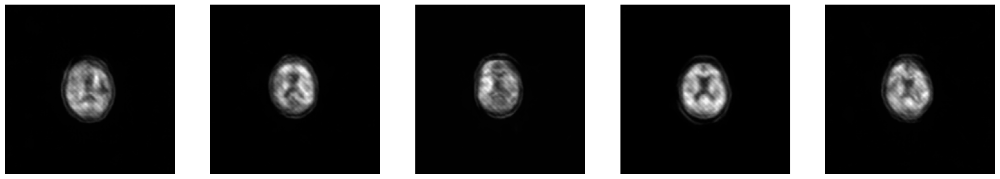

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>154, 0/61, g=1.03995001, d=1.12346554


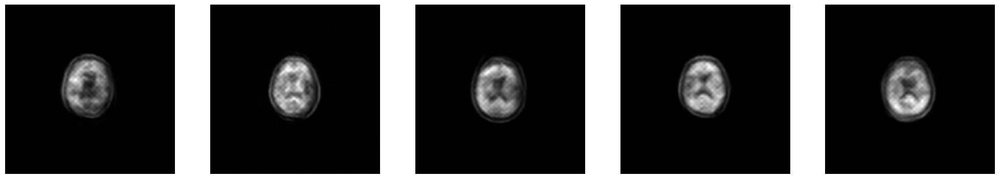

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>155, 0/61, g=1.08493102, d=0.85752761


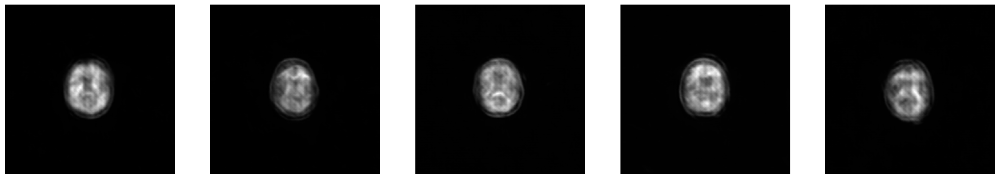

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>156, 0/61, g=1.04212034, d=1.19181275


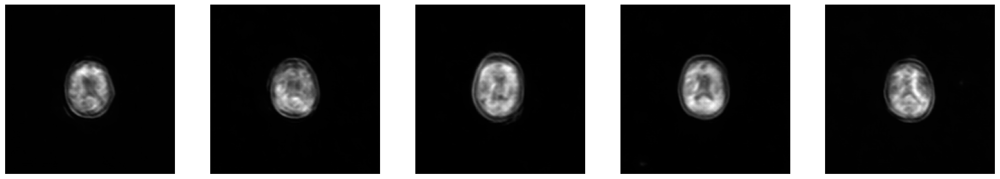

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>157, 0/61, g=1.03403890, d=1.06255198


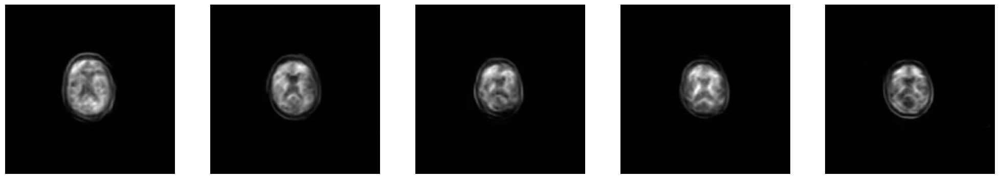

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>158, 0/61, g=1.03991187, d=1.10359430


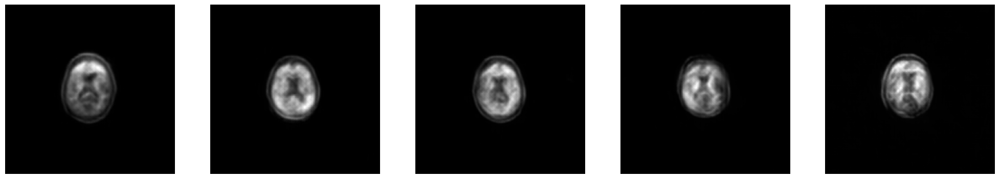

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>159, 0/61, g=1.32809305, d=0.97890317


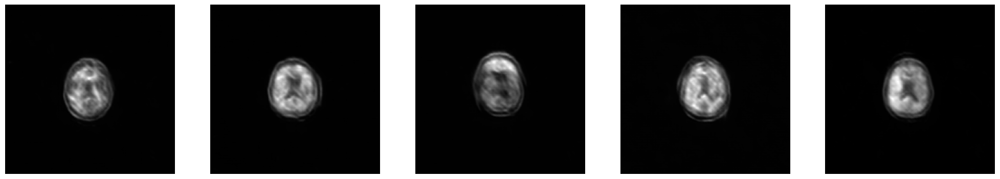

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>160, 0/61, g=0.87224531, d=1.34541917


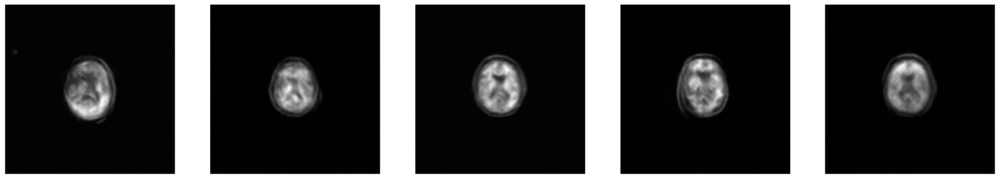

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>161, 0/61, g=1.93570268, d=0.65900743


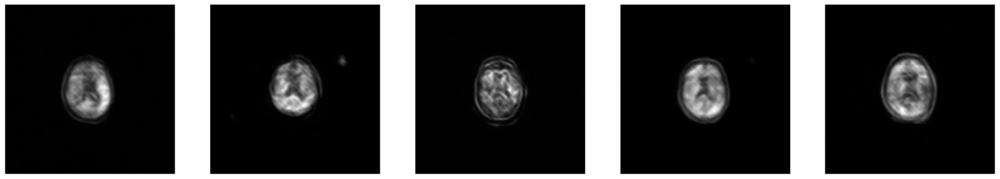

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>162, 0/61, g=1.56412923, d=0.85402203


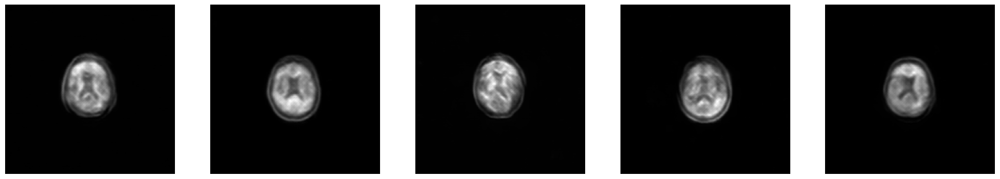

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>163, 0/61, g=1.41384161, d=1.01899588


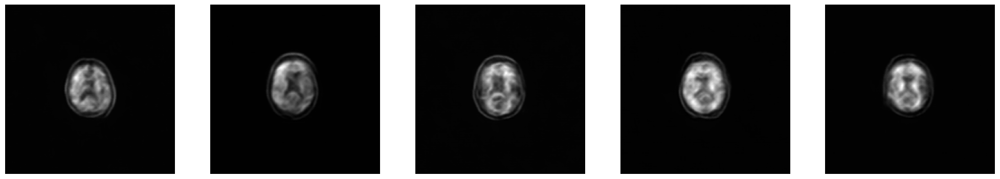

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>164, 0/61, g=1.42982411, d=1.08699298


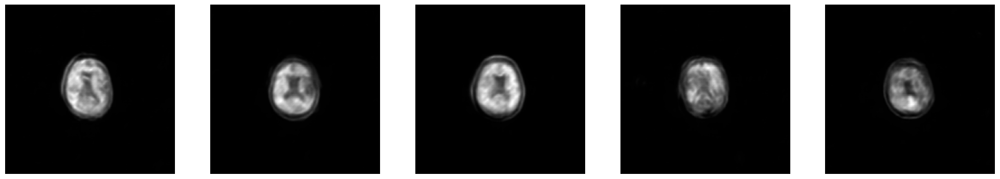

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>165, 0/61, g=1.10254169, d=1.32053792


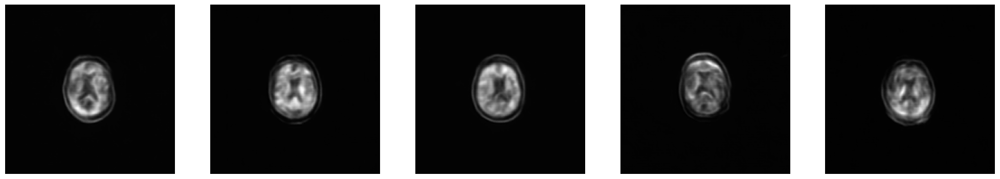

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>166, 0/61, g=0.98241079, d=1.53950739


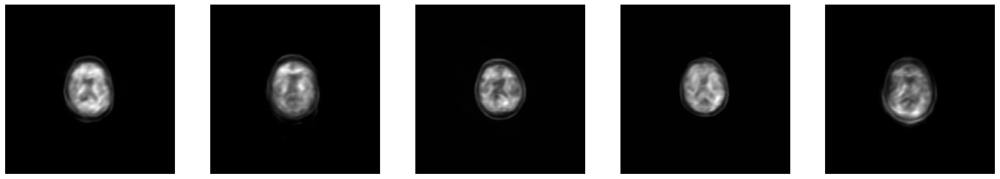

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>167, 0/61, g=1.36277246, d=1.21345830


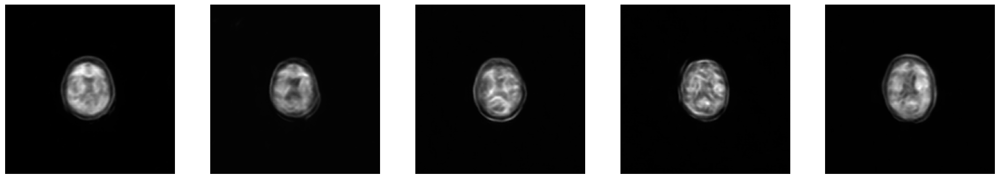

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>168, 0/61, g=1.66053081, d=1.14041030


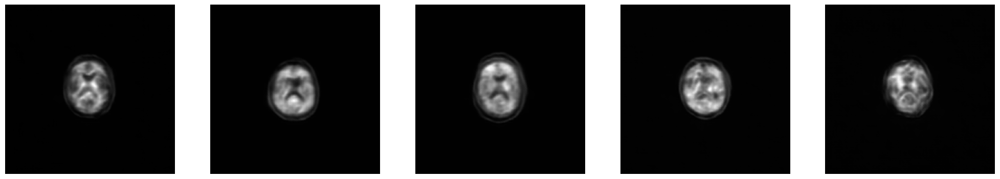

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>169, 0/61, g=1.04166484, d=1.11021399


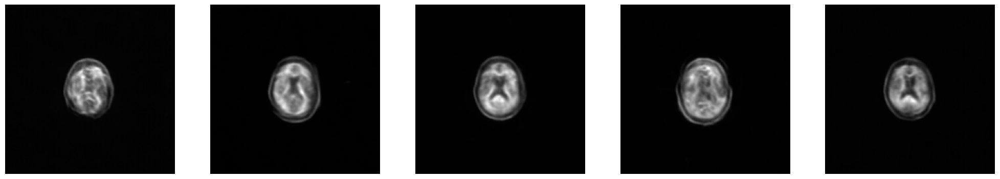

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>170, 0/61, g=1.42275274, d=0.92446864


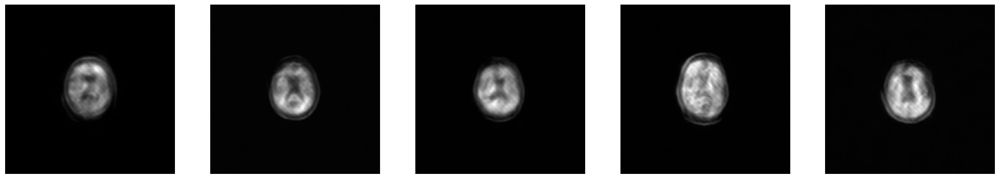

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>171, 0/61, g=0.71881902, d=1.57465243


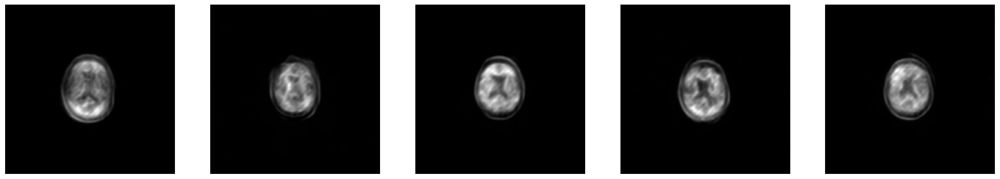

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>172, 0/61, g=1.46329665, d=0.92478985


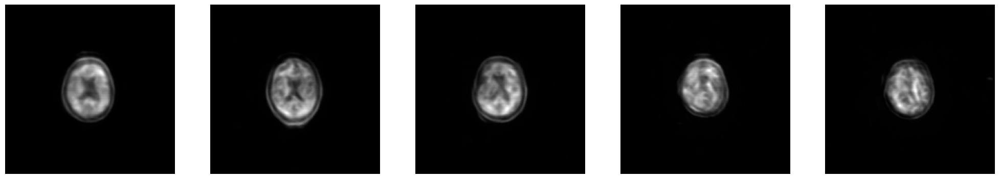

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>173, 0/61, g=1.65908170, d=0.85066050


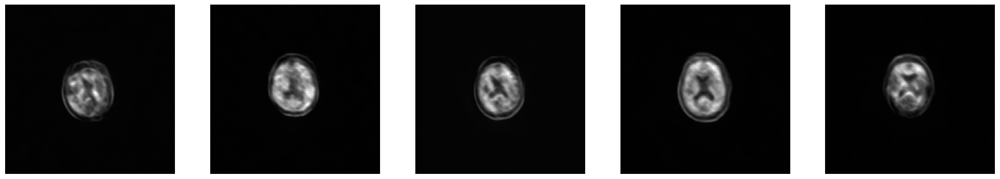

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>174, 0/61, g=1.62027740, d=0.86269855


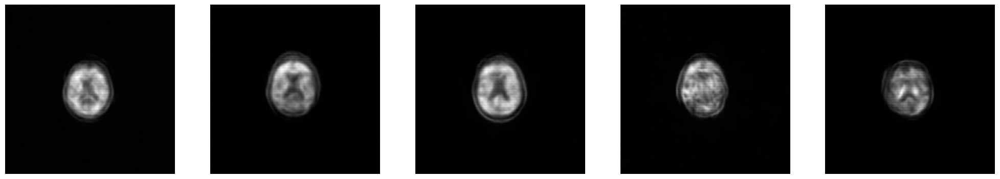

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>175, 0/61, g=1.29589081, d=0.68017769


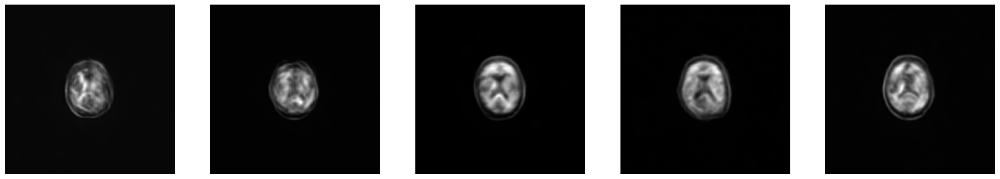

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>176, 0/61, g=0.62050706, d=1.77084959


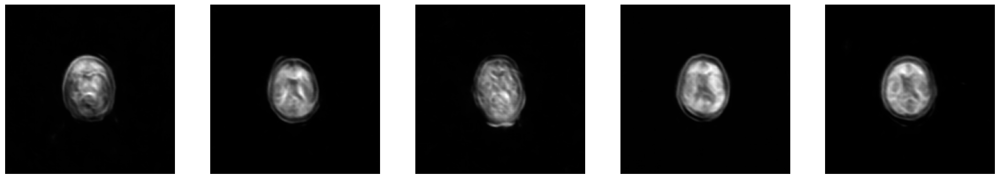

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>177, 0/61, g=1.10157931, d=1.04697490


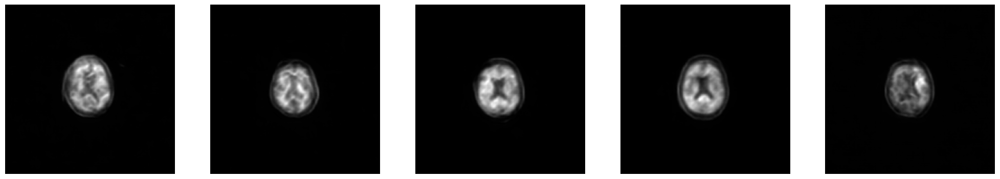

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>178, 0/61, g=1.15662563, d=0.96093833


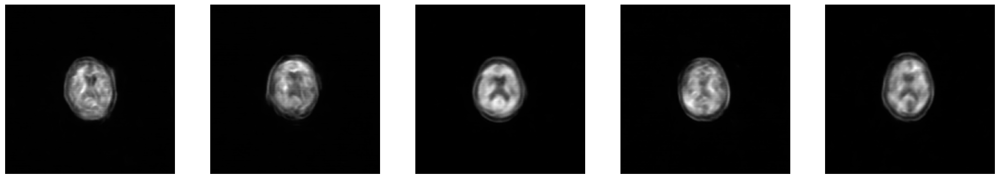

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>179, 0/61, g=1.03992927, d=1.03190601


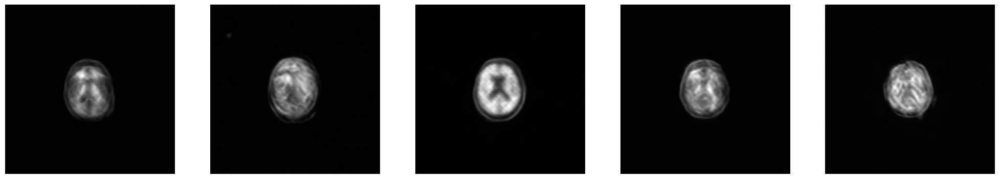

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>180, 0/61, g=1.27057362, d=0.91390693


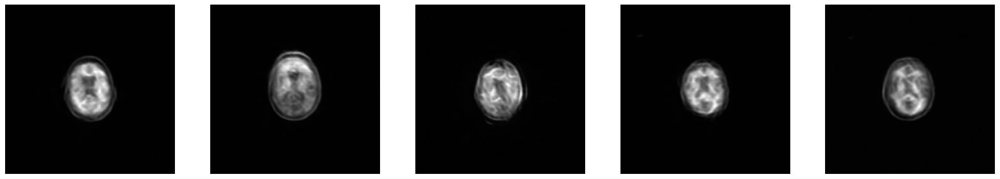

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>181, 0/61, g=1.27894652, d=1.16408157


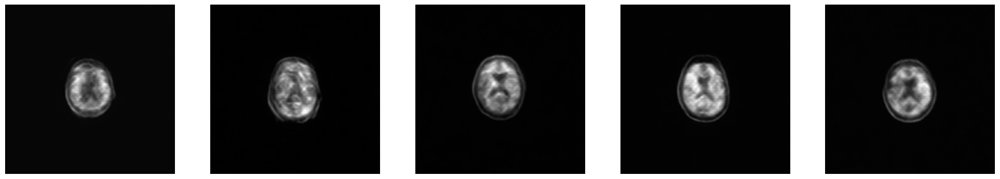

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>182, 0/61, g=1.16129708, d=0.84999150


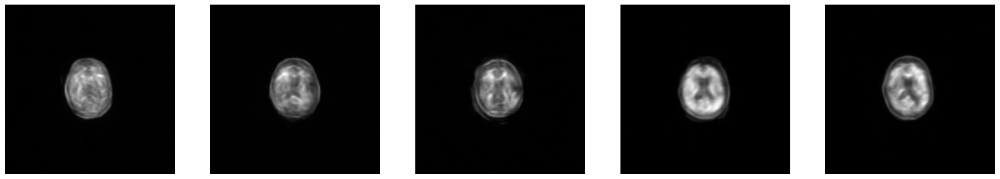

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>183, 0/61, g=0.83938229, d=1.24672353


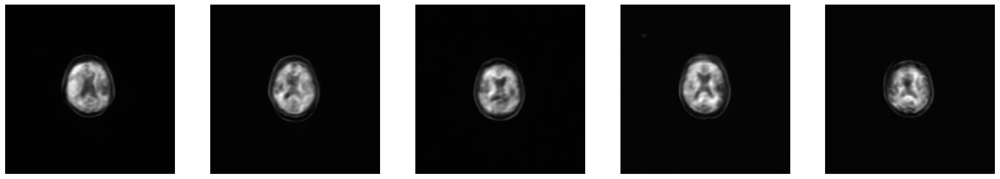

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>184, 0/61, g=1.87228620, d=1.11903191


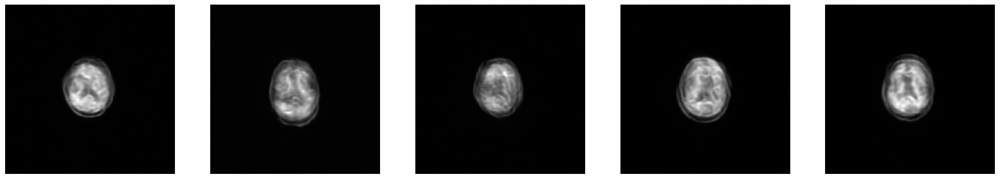

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>185, 0/61, g=1.67524791, d=1.19441116


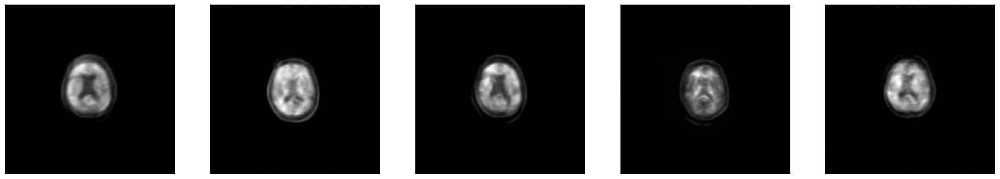

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>186, 0/61, g=0.93867236, d=1.22571111


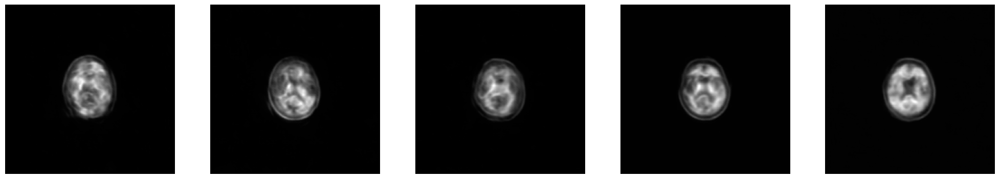

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>187, 0/61, g=0.79615009, d=1.49905777


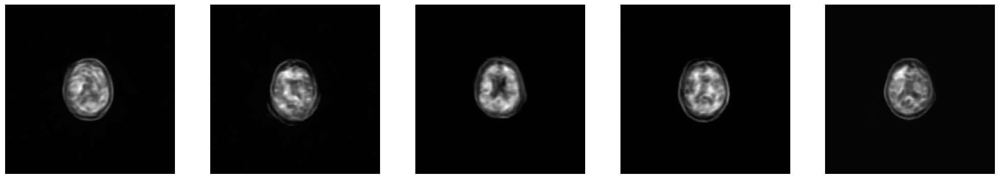

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>188, 0/61, g=1.31547916, d=1.11723530


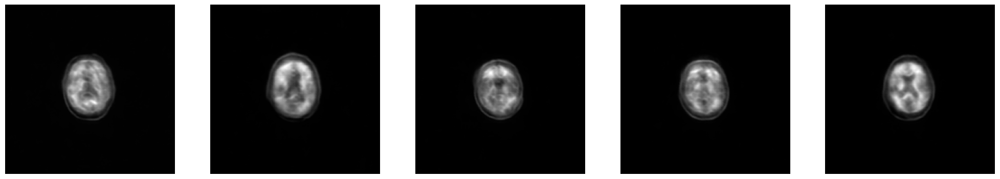

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>189, 0/61, g=1.12572849, d=1.47380877


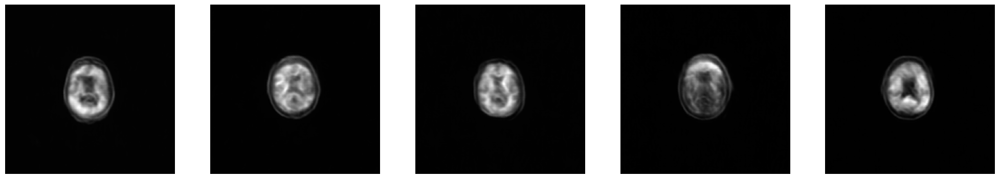

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>190, 0/61, g=1.51662421, d=1.13861346


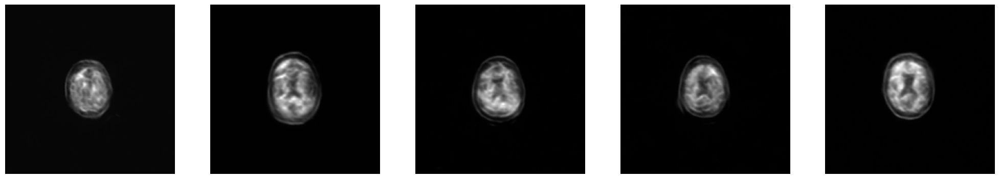

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>191, 0/61, g=0.81757700, d=1.49100649


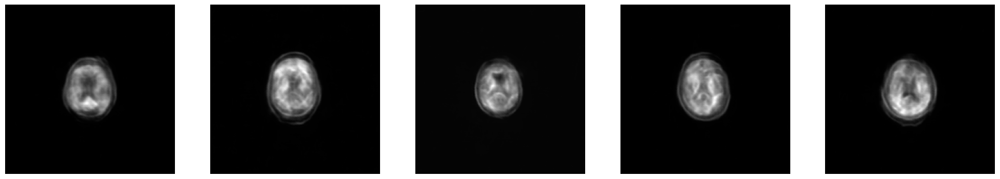

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>192, 0/61, g=1.01031542, d=1.11033082


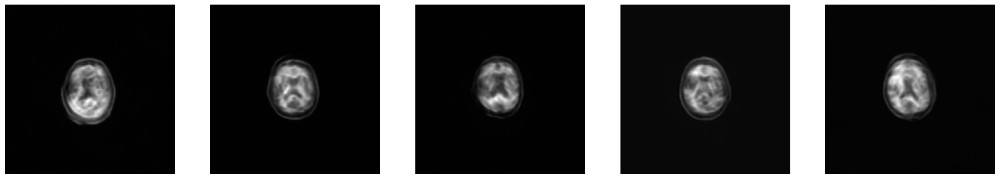

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>193, 0/61, g=1.18451273, d=1.62249100


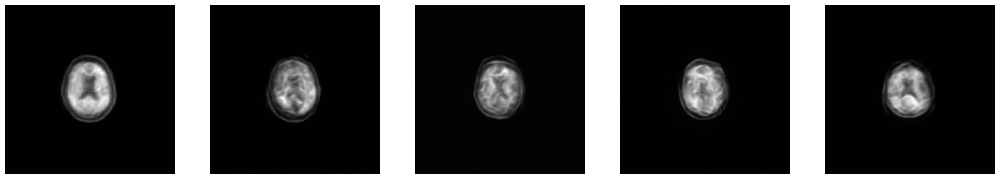

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>194, 0/61, g=1.16923773, d=1.26173806


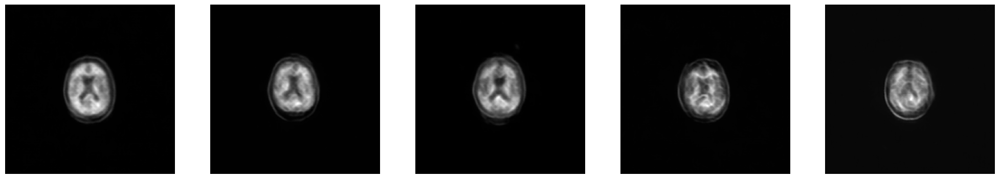

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>195, 0/61, g=0.90701753, d=1.44605041


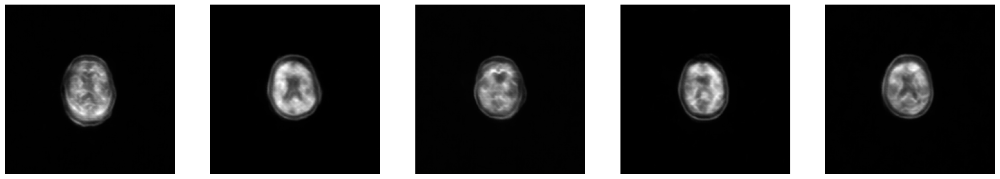

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>196, 0/61, g=1.05828226, d=1.29356241


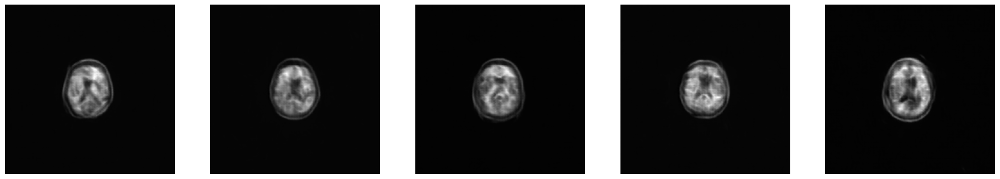

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>197, 0/61, g=1.37940717, d=1.13876474


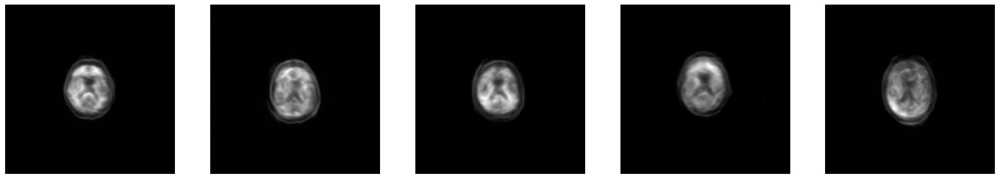

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>198, 0/61, g=0.97803593, d=0.87505120


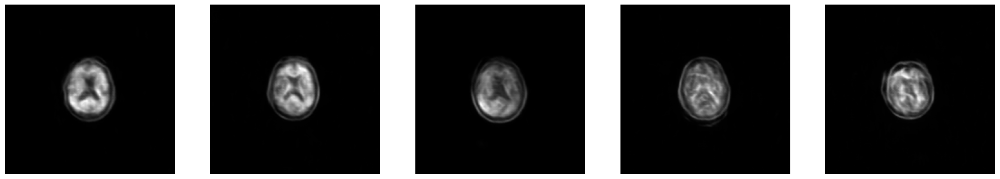

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>199, 0/61, g=1.18365192, d=1.35133553


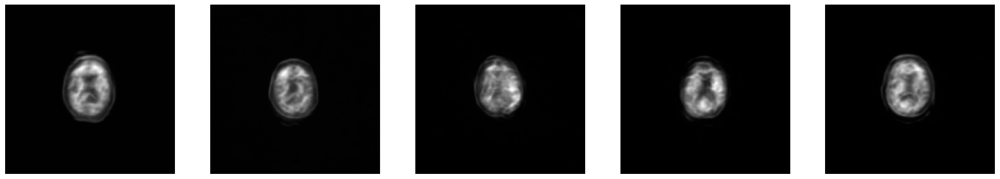

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61


In [43]:
EPOCHS = 200

batch_per_epoch=np.round(training_images.shape[0]/batch_size)

def train(dataset, epochs):
    
    for epoch in range(epochs):
        count=0
        for image_batch in dataset:
          
            g_loss,d_loss=train_step(image_batch) 

            if (count) % 25 == 0:
     
               print('Batch Per Epoch : %d/%d' % (count ,batch_per_epoch))           

            if (count) % 350 == 0:

                print('>%d, %d/%d, g=%.8f, d=%.8f' % (epoch, count, batch_per_epoch, g_loss, d_loss))
                g_loss_history.append(g_loss)
                d_loss_history.append(d_loss) 
                
                noise = tf.random.normal([n_samples, latent_dim])
                x_fake = g_model(noise,training=False)

               
                
                pyplot.figure(figsize=(25,25))
                for i in range(n_samples):

                    pyplot.subplot(5, 5, 1 + i)
                    pyplot.axis('off')
                    pyplot.imshow(x_fake[i, :, :,0],cmap='gray')

                pyplot.show()
                pyplot.close()
            count=count+1

train(train_dataset, EPOCHS)


# **Display generated fake brain images**

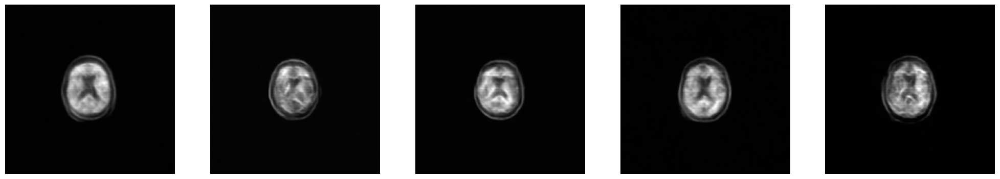

In [132]:
noise = tf.random.normal([n_samples, latent_dim])
x_fake = g_model(noise,training=False)

pyplot.figure(figsize=(25,25))
for i in range(5):
    pyplot.subplot(5, 5, 1 + i)
    pyplot.axis('off')
    pyplot.imshow(x_fake[i, :, :,0],cmap='gray')
    pyplot.savefig('0511 Epoch batch().png')
pyplot.show()
pyplot.close()
filename = 'generator_model_%03d.h5' 
g_model.save(filename)


# **Model evaluation**

**Graph Generator and Discriminator Loss**

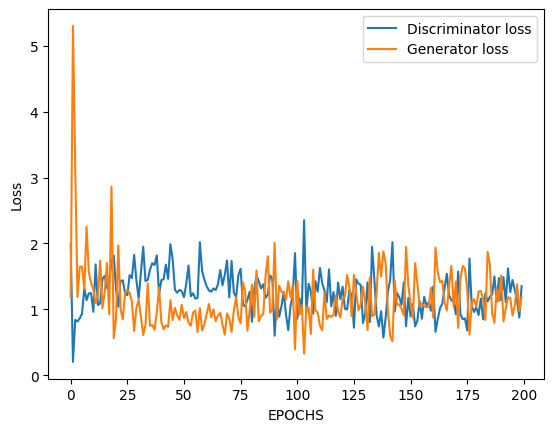

In [45]:
plt.plot(d_loss_history, label='Discriminator loss')
plt.plot(g_loss_history, label='Generator loss')
plt.xlabel('EPOCHS')
plt.ylabel('Loss')
plt.legend()
plt.show()

**SSIM**

In [139]:
whichfake=0
ssim_noise=[]

for i in range(training_images.shape[0]):
    ssim_noise.append( ssim(training_images[i,:,:,0], x_fake.numpy()[whichfake,:,:,0],data_range=np.max(x_fake.numpy()[whichfake,:,:,0]) - np.min(x_fake.numpy()[whichfake,:,:,0])))


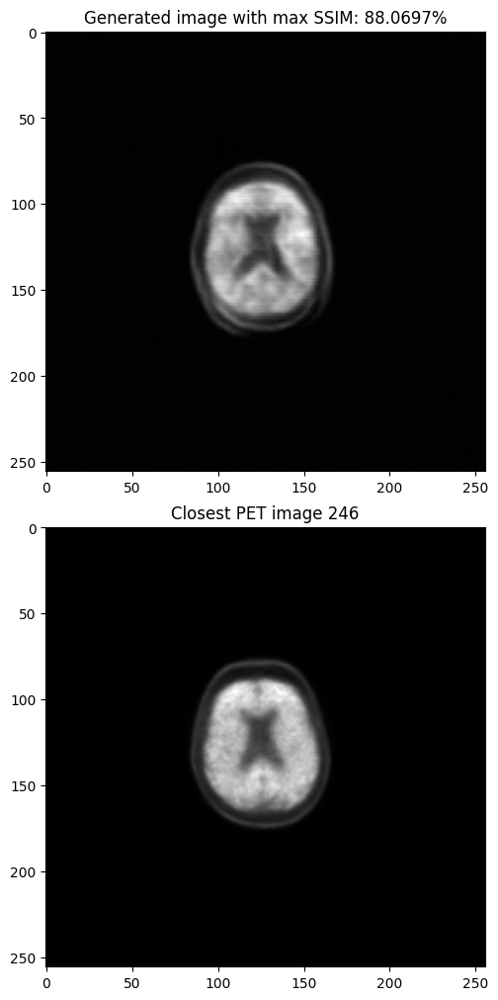

In [140]:
fig, axs = pyplot.subplots(2, 1, constrained_layout=True,figsize=(10,10))
axs[0].imshow(x_fake[whichfake, :, :, 0],cmap="gray")
axs[0].set_title('Generated image with max SSIM: {:.4f}%'.format(np.max(ssim_noise)*100))

axs[1].imshow(training_images[ssim_noise.index(np.max(ssim_noise)), :, :, 0],cmap="gray")
axs[1].set_title('Closest PET image {:.0f}'.format(ssim_noise.index(np.max(ssim_noise))))

pyplot.show()